## Third pharyngeal pouch subset analysis

Code by Hananeh Aliee (Fabian Theis group)

In [1]:
%config InlineBackend.figure_formats = ['retina']  # increase resolution on retina screens
import numpy as np
import pandas as pd
import scanpy as sc
import scipy as sci
import re
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import scvelo as scv

sc.settings.verbosity = 3                # amount of output
sc.settings.figdir = './figs_4March20/'#'./figs_June26/'
sc.settings.writedir = './'
#sc.settings.set_dpi(60) # low pixel number yields small inline figures
sc.logging.print_version_and_date()
results_file = './write_4March20/results/' #'./write_June11/results/'

/home/icb/hananeh.aliee/.local/lib/python3.6/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex
/home/icb/hananeh.aliee/.local/lib/python3.6/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Running Scanpy 1.5.1, on 2020-07-14 15:46.


In [2]:
sc.set_figure_params(dpi=200, dpi_save=300, vector_friendly=True, frameon=False)

In [3]:
mpl.rcParams['figure.figsize'] = (3, 3)

# 1. Read Inputs

### 1.1 read the whole atlas (scaled)

In [4]:
file_meta = './processedData/metadata.tsv'
meta_raw = pd.read_table(file_meta,index_col=0)

meta file is read


In [5]:
import loompy
file = './processedData/all/'
ds1 = loompy.connect(file+'CR_pharynx_E9_5_rep1.loom')
ds2 = loompy.connect(file+'CR_pharynx_E9_5_rep2.loom')
ds3 = loompy.connect(file+'CR_pharynx_E10_5_rep5.loom')
ds4 = loompy.connect(file+'CR_pharynx_E10_5_rep6.loom')
ds5 = loompy.connect(file+'CR_pharynx_E10_5_rep7.loom')
ds6 = loompy.connect(file+'CR_pharynx_E11_5_rep2.loom')
ds7 = loompy.connect(file+'CR_pharynx_E11_5_rep2B.loom')
ds8 = loompy.connect(file+'CR_pharynx_E11_5_rep3.loom')
ds9 = loompy.connect(file+'CR_pharynx_E12_5_rep1.loom')
ds10= loompy.connect(file+'CR_pharynx_E12_5_rep2.loom')

In [ ]:
X_concatenated = np.concatenate([ds1.layers[''][:,:].T,
                                   ds2.layers[''][:,:].T,
                                   ds3.layers[''][:,:].T,
                                   ds4.layers[''][:,:].T,
                                   ds5.layers[''][:,:].T,
                                   ds6.layers[''][:,:].T,
                                   ds7.layers[''][:,:].T,
                                   ds8.layers[''][:,:].T,
                                   ds9.layers[''][:,:].T,
                                   ds10.layers[''][:,:].T], axis=0)

In [7]:
adata = sc.AnnData(X_concatenated)

In [8]:
adata

AnnData object with n_obs × n_vars = 54044 × 27998 

In [9]:
file_cells= './processedData/cellnames/all/'
cells_1 = pd.read_table(file_cells+'CR_pharynx_E9_5_rep1'+'__cellnames.csv',header=None)
cells_2 = pd.read_table(file_cells+'CR_pharynx_E9_5_rep2'+'__cellnames.csv',header=None)
cells_3 = pd.read_table(file_cells+'CR_pharynx_E10_5_rep5'+'__cellnames.csv',header=None)
cells_4 = pd.read_table(file_cells+'CR_pharynx_E10_5_rep6'+'__cellnames.csv',header=None)
cells_5 = pd.read_table(file_cells+'CR_pharynx_E10_5_rep7'+'__cellnames.csv',header=None)
cells_6 = pd.read_table(file_cells+'CR_pharynx_E11_5_rep2'+'__cellnames.csv',header=None)
cells_7 = pd.read_table(file_cells+'CR_pharynx_E11_5_rep2B'+'__cellnames.csv',header=None)
cells_8 = pd.read_table(file_cells+'CR_pharynx_E11_5_rep3'+'__cellnames.csv',header=None)
cells_9 = pd.read_table(file_cells+'CR_pharynx_E12_5_rep1'+'__cellnames.csv',header=None)
cells_10 = pd.read_table(file_cells+'CR_pharynx_E12_5_rep2'+'__cellnames.csv',header=None)

In [10]:
barcodes = np.concatenate([cells_1,cells_2,cells_3,cells_4,cells_5,cells_6,cells_7,cells_8,cells_9,cells_10], axis=0)
adata.obs_names = barcodes.reshape(1,-1)[0]

In [11]:
barcodes.shape

(54044, 1)

In [12]:
file_genes = './data_dec14/current_best/genes.tsv' # gene labels
genes = pd.read_table(file_genes,header=None)
adata.var_names = genes.iloc[:,1]

In [14]:
adata.write(results_file+"./adata_raw.h5ad")

In [14]:
adata = sc.read(results_file+"adata_raw.h5ad")

In [15]:
file_meta_old = './data_dec14/current_best/metadata_2019FEB28.tsv'
meta_old = pd.read_table(file_meta_old)
meta_old = meta_old.loc[adata.obs_names]

In [16]:
print(np.all(adata.obs_names==meta_old.index))

True


In [17]:
adata_proc = adata.copy()

In [18]:
for s in meta_old.columns.values:
    adata_proc.obs[s] = meta_old[s].tolist()

meta_raw = meta_raw.loc[adata.obs_names]
for s in meta_raw.columns.values:
    adata_proc.obs[s] = meta_raw[s].tolist()

adata_proc.obs['day_str'] = [str(x) for x in adata_proc.obs['eday']] 

In [23]:
adata_proc

AnnData object with n_obs × n_vars = 54044 × 27998 
    obs: 'barcode', 'orig.ident', 'eday', 'ident', 'nGene', 'nUMI', 'log10_nUMI', 'S.Score', 'G2M.Score', 'Phase', 'pANN', 'is_doublet', 'pouch3', 'pouches', 'Il7_pos', 'cluster', 'UMAP1', 'UMAP2', 'Il7pos', 'pouch34', 'cluster_name', 'day_str'

In [24]:
adata_proc.write(results_file+"./adata_proc.h5ad")

... storing 'barcode' as categorical
... storing 'orig.ident' as categorical
... storing 'ident' as categorical
... storing 'Phase' as categorical
... storing 'cluster_name' as categorical
... storing 'day_str' as categorical


In [5]:
adata_proc = sc.read(results_file+"adata_proc.h5ad")

### 1.2 Read KO data

In [4]:
KO_path = './processedData/foxn1_experiment_thymic_cells/'
adata_KO = sc.read_10x_mtx(KO_path)
file_meta = './processedData/foxn1_experiment_thymic_cells/metadata.tsv'
meta_KO = pd.read_table(file_meta,index_col=0)

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.


In [6]:
meta_KO = meta_KO.loc[adata_KO.obs_names]
for s in meta_KO.columns.values:
    adata_KO.obs[s] = meta_KO[s].tolist()

In [7]:
adata_KO_proc = adata_KO.copy()
adata_KO_proc.X = adata_KO_proc.X.toarray()

In [8]:
sc.pp.normalize_total(adata_KO_proc,target_sum=10000)
adata_KO_log_norm = sc.pp.log1p(adata_KO_proc,copy=True) 
adata_KO_proc = sc.pp.scale(adata_KO_log_norm,copy=True)

normalizing counts per cell
    finished (0:00:00)


### 1.3 read the whole atlas (log_normalized)

In [9]:
log_norm_path = './processedData/log1p_normalized/'
adata_log_norm = sc.read_10x_mtx(log_norm_path)
file_meta = './processedData/log1p_normalized/metadata.tsv'
meta_log_norm = pd.read_table(file_meta,index_col=0)

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.


In [10]:
meta_log_norm = meta_log_norm.loc[adata_log_norm.obs_names]
for s in meta_log_norm.columns.values:
    adata_log_norm.obs[s] = meta_log_norm[s].tolist()

### 1.4 select the third pouch

In [11]:
file_hvs = './processedData/variable_genes/pouch3/all/'
pouch3_hvs = pd.read_table(file_hvs+'variable_genes_corrected.csv',index_col=0)

In [12]:
adata_pouch3 =  adata_proc[adata_proc.obs_names[adata_proc.obs['pouch3']==1]].copy()
adata_pouch3.var['highly_variable'] = False
for hv in pouch3_hvs.index:
    adata_pouch3.var.loc[hv,'highly_variable'] = True

In [13]:
adata_pouch3_log_norm =  adata_log_norm[adata_log_norm.obs_names[adata_log_norm.obs['pouch3']==1]].copy()
adata_pouch3_log_norm.var['highly_variable'] = False
for hv in pouch3_hvs.index:
    adata_pouch3_log_norm.var.loc[hv,'highly_variable'] = True
adata_pouch3_log_norm = adata_pouch3_log_norm[:,adata_pouch3.var_names]

In [14]:
adata_pouch3

AnnData object with n_obs × n_vars = 9256 × 27998 
    obs: 'barcode', 'orig.ident', 'eday', 'ident', 'nGene', 'nUMI', 'log10_nUMI', 'S.Score', 'G2M.Score', 'Phase', 'pANN', 'is_doublet', 'pouch3', 'pouches', 'Il7_pos', 'cluster', 'UMAP1', 'UMAP2', 'Il7pos', 'pouch34', 'cluster_name', 'day_str'
    var: 'highly_variable'

In [15]:
adata_pouch3_log_norm

View of AnnData object with n_obs × n_vars = 9256 × 27998 
    obs: 'nGene', 'nUMI', 'orig.ident', 'eday', 'nUMI_mt', 'nUMI_rp', 'nUMI_pct_mt', 'nUMI_pct_rp', 'mt_nUMI_pct', 'ribo_nUMI_pct', 'Y_genes', 'res.2', 'ident0', 'ident1', 'ident2', 'ident3', 'ident4', 'ident5', 'ident6', 'ident7', 'ident8', 'ident9', 'ident10', 'ident11', 'ident12', 'ident13', 'ident14', 'ident15', 'ident16', 'ident17', 'ident18', 'ident19', 'ident20', 'ident21', 'ident22', 'ident23', 'ident24', 'ident25', 'ident26', 'ident27', 'ident28', 'ident29', 'ident30', 'ident31', 'ident32', 'ident33', 'ident34', 'ident35', 'ident36', 'ident37', 'ident38', 'ident39', 'ident40', 'ident41', 'ident42', 'S.Score', 'G2M.Score', 'Phase', 'log10_nUMI', 'nUMI_means', 'log10_nUMI_rep_adjusted', 'is_low_quality', 'nUMI_pct_mt_capped', 'pANN', 'pANNPredictions', 'is_doublet', 'XY', 'excess_XY_given_nUMI', 'collagen_total', 'hb_total', 'preliminary_ident', 'included', 'basis_e12', 'basis_e9', 'basis_e10a', 'basis_e10b', 'basis_e11a

In [46]:
adata_pouch3_log_norm.write(results_file+"adata_pouch3_log_norm.h5ad")

In [16]:
adata_pouch3.write(results_file+"adata_pouch3.h5ad")

In [17]:
adata_pouch3 = sc.read(results_file+"adata_pouch3.h5ad")

In [18]:
adata_KO_proc = adata_KO_proc[:,adata_pouch3.var_names]
adata_KO_log_norm = adata_KO_log_norm[:,adata_pouch3.var_names]

In [19]:
adata_KO_proc.var['highly_variable'] = adata_pouch3.var['highly_variable']
adata_KO_log_norm.var['highly_variable'] = adata_pouch3.var['highly_variable']
adata_pouch3_log_norm.var['highly_variable'] = adata_pouch3.var['highly_variable']

Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.
Trying to set attribute `.var` of view, copying.


# Downstream analysis

# 2. Visualization

### 2.1 Whole atlas

In [27]:
adata_proc.obsm['X_umap'] = adata_proc.obs[['UMAP1','UMAP2']].values

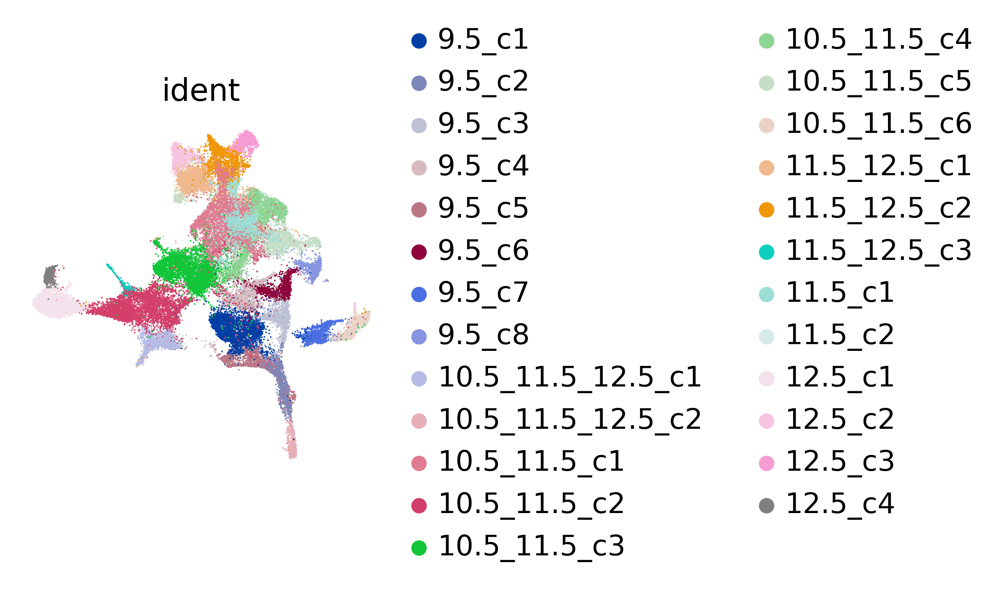

In [28]:
sc.pl.umap(adata_proc, color='ident',save="_all_umap_ident.pdf")

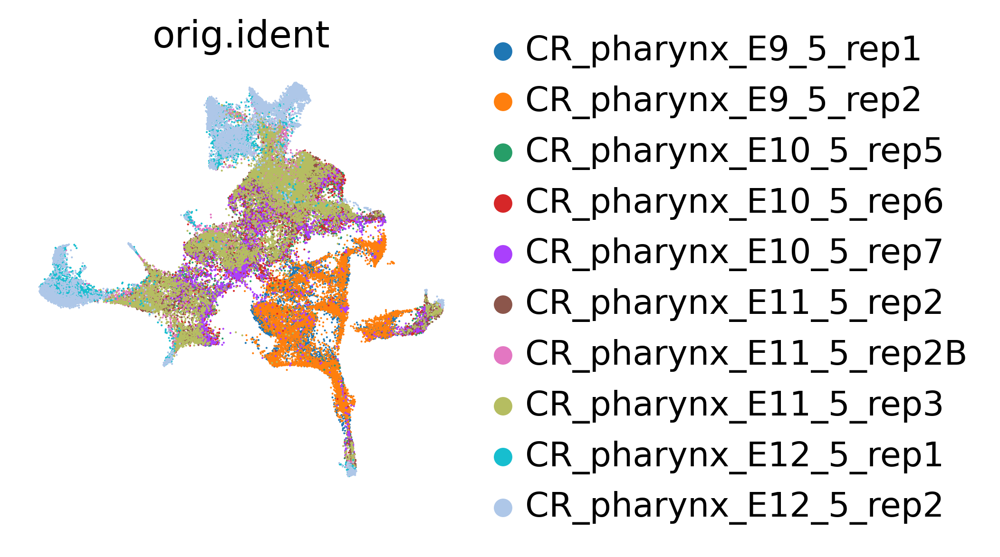

In [29]:
sc.pl.umap(adata_proc, color='orig.ident',save="_all_umap_orig.ident.pdf")

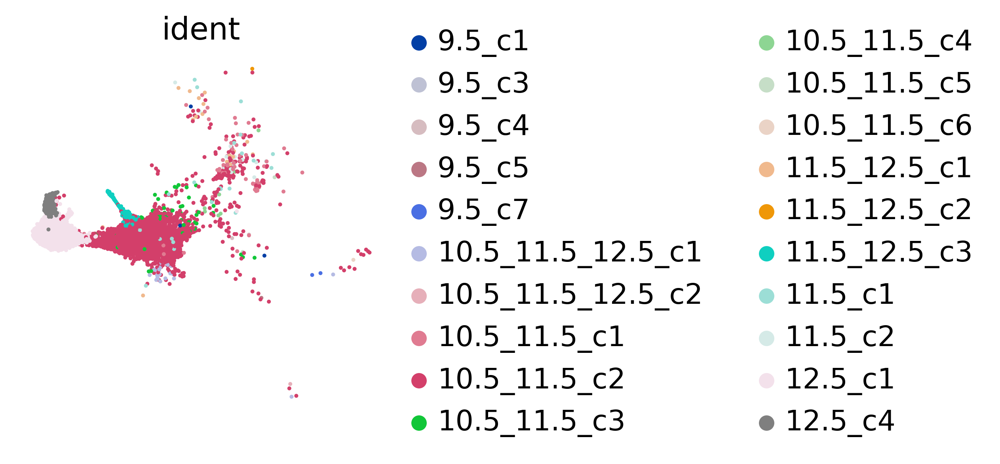

In [30]:
sc.pl.umap(adata_proc[adata_proc.obs_names[adata_proc.obs['pouch3']==1]], color='ident',save="_3_cropped_umap_ident.pdf")

### 2.2 third pouch

Visualisation of third pouch:

    * performing PCA on the scaled data using highly variable genes (#pcs=50)
    * KNN graph on the first 50 PCs with n=30 neighbors
    

    on highly variable genes
computing PCA with n_comps = 50
    finished (0:00:02)


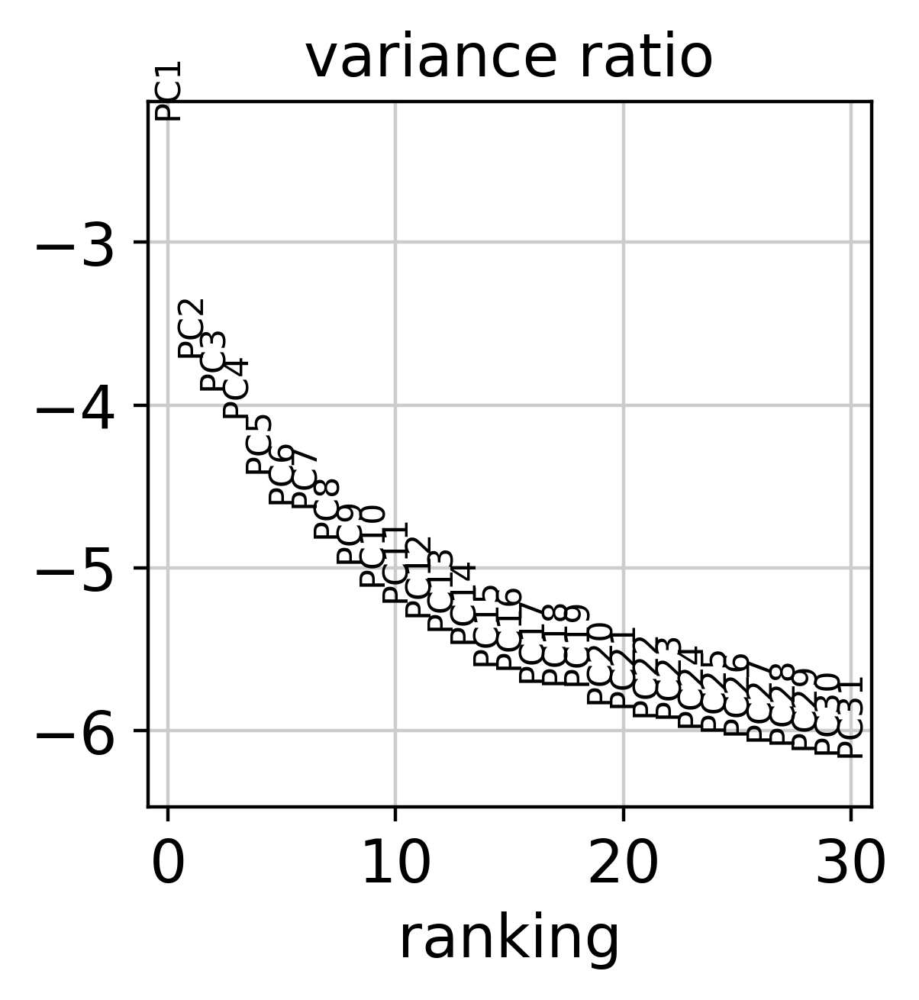

In [20]:
sc.pp.pca(adata_pouch3, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata_pouch3, log=True)

In [21]:
sc.pp.neighbors(adata_pouch3, n_neighbors=30) #, n_pcs = 30, n_neighbors=100, use_rep=None, knn=True, random_state=0, method='umap', metric='euclidean', metric_kwds={}, copy=False

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:14)


In [22]:
sc.tl.tsne(adata_pouch3, n_jobs=12)
sc.tl.umap(adata_pouch3)
sc.tl.diffmap(adata_pouch3)
sc.tl.draw_graph(adata_pouch3)

computing tSNE
    using 'X_pca' with n_pcs = 50
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:23)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:44)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.99318045 0.9919958  0.9675739  0.9535822  0.94401973
     0.9413508  0.9283543  0.92096287 0.8962784  0.88774747 0.8787314
     0.8748585  0.8705264  0.86975473]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:01:17)


In [23]:
adata_pouch3

AnnData object with n_obs × n_vars = 9256 × 27998 
    obs: 'barcode', 'orig.ident', 'eday', 'ident', 'nGene', 'nUMI', 'log10_nUMI', 'S.Score', 'G2M.Score', 'Phase', 'pANN', 'is_doublet', 'pouch3', 'pouches', 'Il7_pos', 'cluster', 'UMAP1', 'UMAP2', 'Il7pos', 'pouch34', 'cluster_name', 'day_str'
    var: 'highly_variable'
    uns: 'pca', 'neighbors', 'umap', 'diffmap_evals', 'draw_graph'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'X_diffmap', 'X_draw_graph_fa'
    varm: 'PCs'

In [24]:
adata_pouch3.obs['eday'] = adata_pouch3.obs['eday'].astype('category')

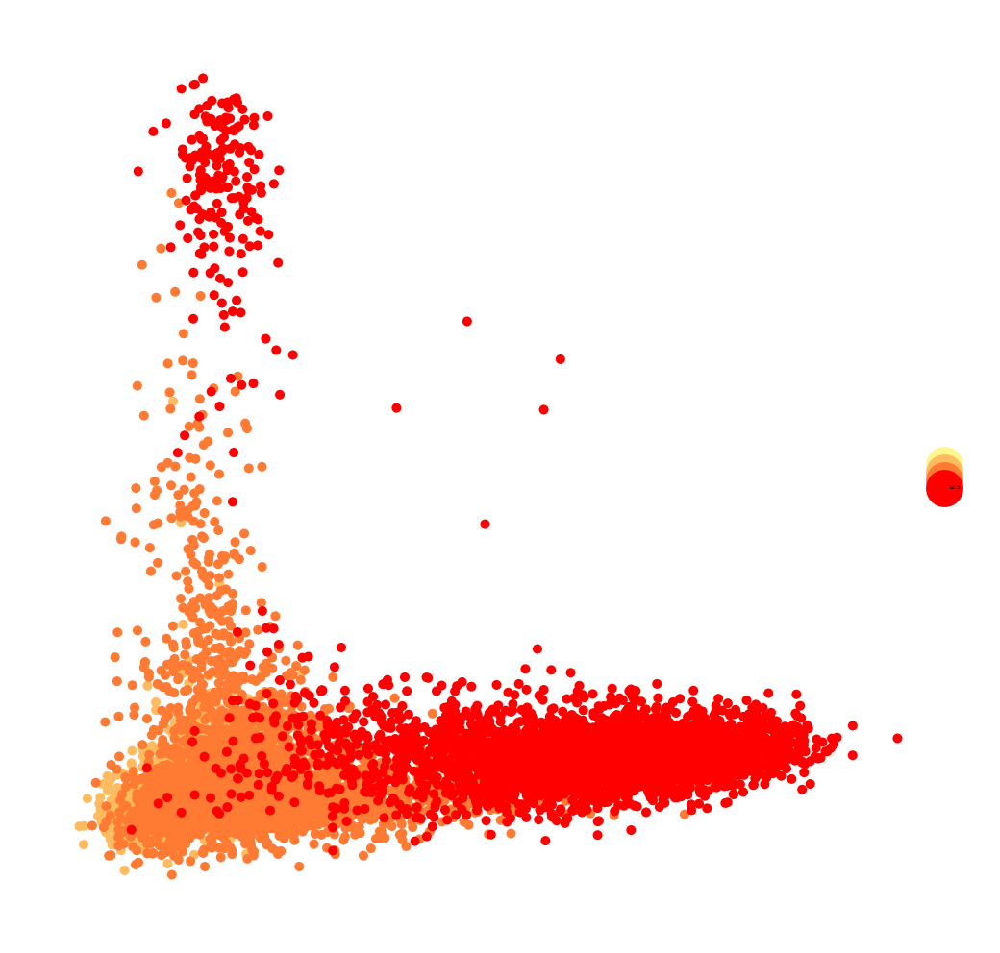

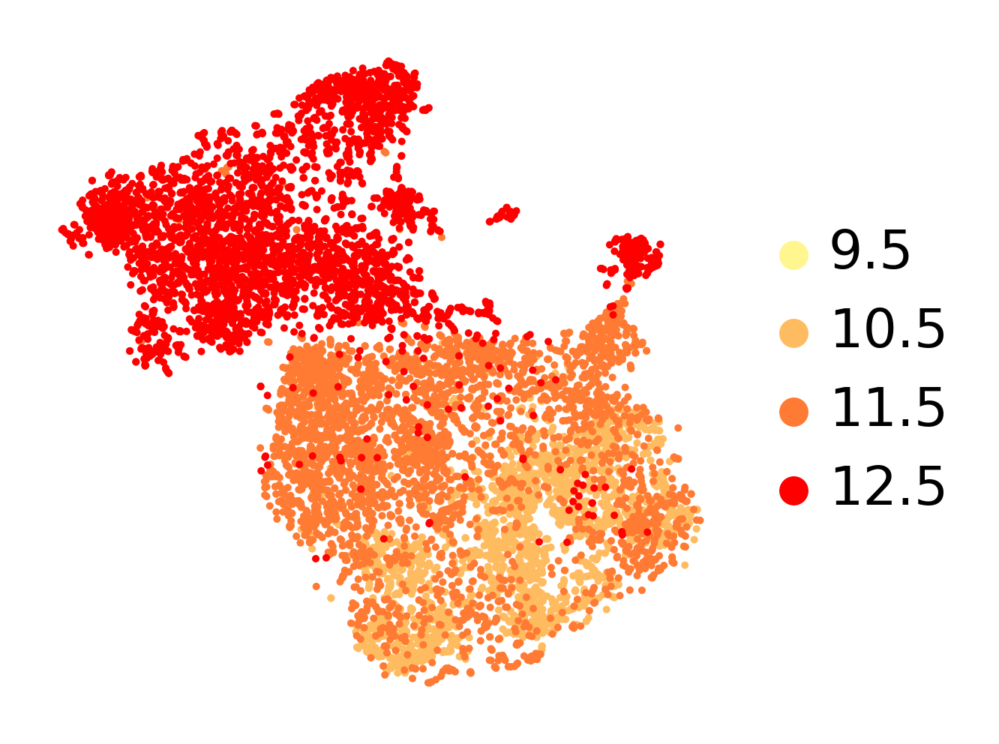

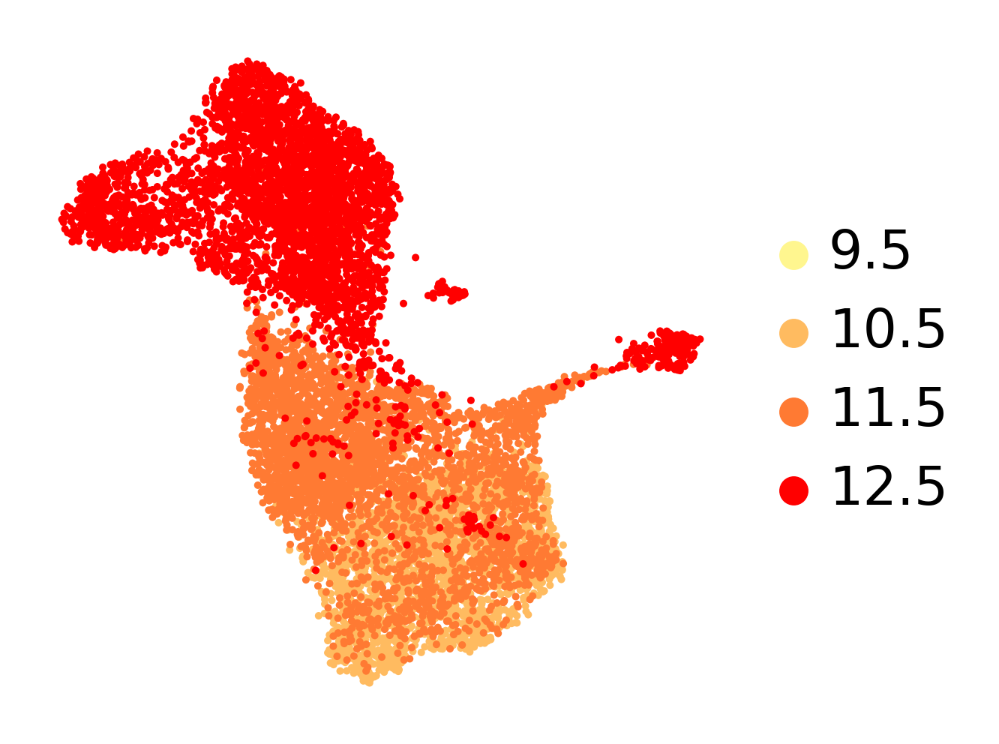

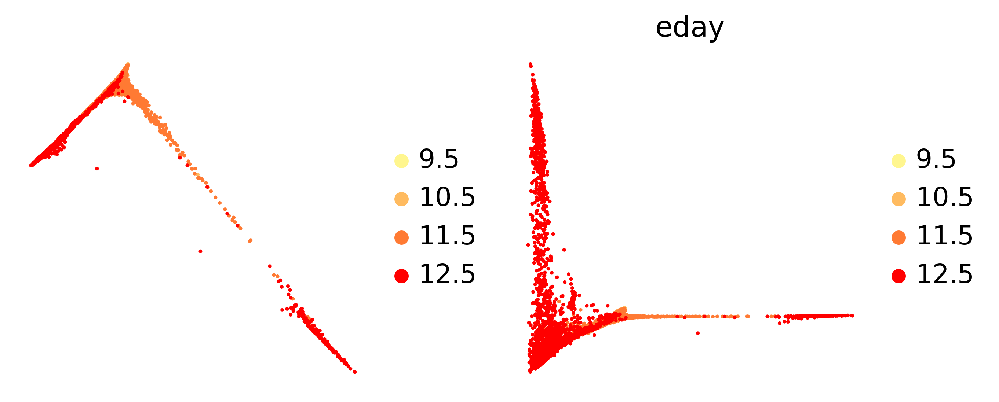

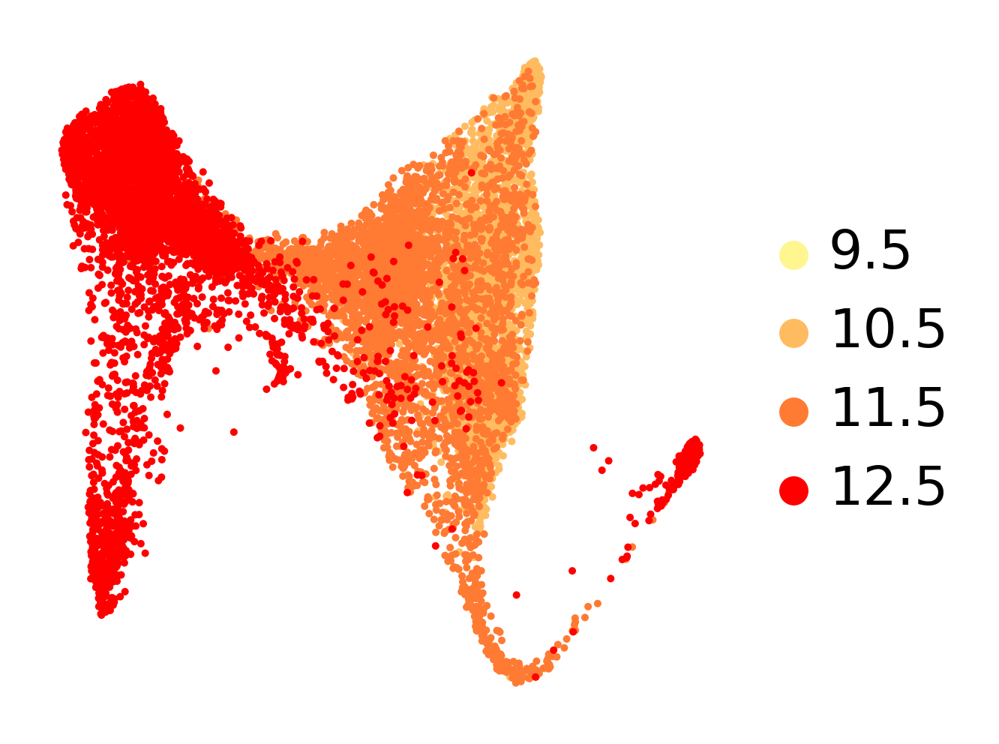

In [25]:
sc.pl.pca_scatter(adata_pouch3, color='eday',save="_3_pca_ident.pdf", legend_fontsize=1,title='',palette=["#FFF68F","#FFBB60","#FF7A33","#FF0000"])
sc.pl.tsne(adata_pouch3, color='eday',save="_3_tsne_ident.pdf",title='', palette=["#FFF68F","#FFBB60","#FF7A33","#FF0000"])
sc.pl.umap(adata_pouch3, color='eday',save="_3_umap_ident.pdf",title='', palette=["#FFF68F","#FFBB60","#FF7A33","#FF0000"])
sc.pl.diffmap(adata_pouch3, color='eday', components=['1,2','1,3'],save="_3_diffmap_ident.pdf",title='', palette=["#FFF68F","#FFBB60","#FF7A33","#FF0000"])
sc.pl.draw_graph(adata_pouch3, color='eday',save="_3_draw_ident.pdf",title='', palette=["#FFF68F","#FFBB60","#FF7A33","#FF0000"])

In [26]:
adata_pouch3.write(results_file+"adata_pouch3_av.h5ad")

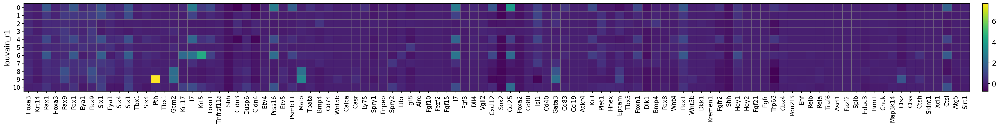

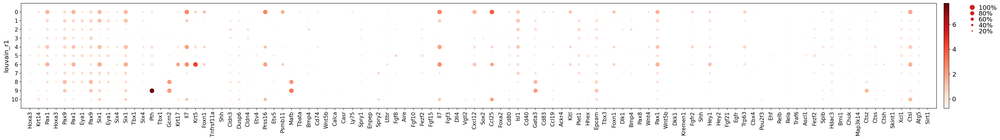

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[36.4, 0, 0.2, 0.5, 0.25])

In [43]:
expected_genes = ['3pp','TEC','Hoxa3','Krt14','Pax1','Hoxa3','Pax9','Pax1','Eya1','Pax9','Six1','Eya1','Six4','Six1','Tbx1','Six4','Pth','Tbx1','Gcm2','Krt17',
                  'Il7','Krt5','Foxn1','Tnfrsf11a','Shh','Cldn3','Dusp6','Cldn4','Etv4','Prss16','Etv5','Psmb11','Mafb','Tbata','Bmp4','Cd74','Wnt5b',
                  'H2-Aa','Calca','H2-Eb1','Casr','Ly75','Spry1','Enpep','Spry2','Ltbr','Fgf8','Aire','Fgf10','Fezf2','Fgf15','Il7','Fgf3','Dll4','Vgll2',
                  'Cxcl12','Sox2','Ccl25','Foxa2','Cd80','Isl1','Cd40','Gata3','Cd83','Nkx2-5','Ccl19','Nkx2-6','Ackr4','Nkx2-1','Kitl','Nkx2-3','Plet1',
                  'Hhex','Epcam','Tbx3','Foxn1','Dlk1','Bmp4','Pax8','Wnt4','Pax1','Wnt5b','Dkk1','Kremen1','Fgfr2','Shh','Hey1','Hey2','Fgf21','Egfr',
                  'Trp63','Cbx4','Pou2f3','Ehf','Relb','Rela','Traf6','Ascl1','Fezf2','Spib','Hdac3','Bmi1','Chuk','Map3k14','Ctsz','Ctss','Ctsh','Skint1',
                  'Xcl1','Ctsl','Atg5','Sirt1']
expected_genes_proc = [x for x in expected_genes if x in adata_pouch3.var_names]
sc.set_figure_params( dpi_save=300)
sc.pl.matrixplot(adata_pouch3, expected_genes_proc, groupby='louvain_r1',save= '_selectedgenes.pdf')
sc.pl.dotplot(adata_pouch3, expected_genes_proc, groupby='louvain_r1',save= '_selectedgenes.pdf')
#sc.pl.violin(adata_pouch3, expected_genes_proc, groupby='louvain_r1')

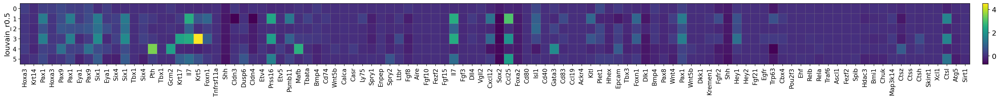

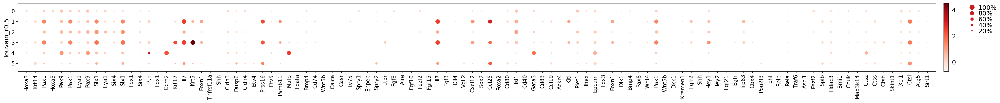

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[36.4, 0, 0.2, 0.5, 0.25])

In [44]:
expected_genes = ['3pp','TEC','Hoxa3','Krt14','Pax1','Hoxa3','Pax9','Pax1','Eya1','Pax9','Six1','Eya1','Six4','Six1','Tbx1','Six4','Pth','Tbx1','Gcm2','Krt17',
                  'Il7','Krt5','Foxn1','Tnfrsf11a','Shh','Cldn3','Dusp6','Cldn4','Etv4','Prss16','Etv5','Psmb11','Mafb','Tbata','Bmp4','Cd74','Wnt5b',
                  'H2-Aa','Calca','H2-Eb1','Casr','Ly75','Spry1','Enpep','Spry2','Ltbr','Fgf8','Aire','Fgf10','Fezf2','Fgf15','Il7','Fgf3','Dll4','Vgll2',
                  'Cxcl12','Sox2','Ccl25','Foxa2','Cd80','Isl1','Cd40','Gata3','Cd83','Nkx2-5','Ccl19','Nkx2-6','Ackr4','Nkx2-1','Kitl','Nkx2-3','Plet1',
                  'Hhex','Epcam','Tbx3','Foxn1','Dlk1','Bmp4','Pax8','Wnt4','Pax1','Wnt5b','Dkk1','Kremen1','Fgfr2','Shh','Hey1','Hey2','Fgf21','Egfr',
                  'Trp63','Cbx4','Pou2f3','Ehf','Relb','Rela','Traf6','Ascl1','Fezf2','Spib','Hdac3','Bmi1','Chuk','Map3k14','Ctsz','Ctss','Ctsh','Skint1',
                  'Xcl1','Ctsl','Atg5','Sirt1']
expected_genes_proc = [x for x in expected_genes if x in adata_pouch3.var_names]
sc.set_figure_params( dpi_save=300)
sc.pl.matrixplot(adata_pouch3, expected_genes_proc, groupby='louvain_r0.5',save= '_selectedgenes_r05.pdf')
sc.pl.dotplot(adata_pouch3, expected_genes_proc, groupby='louvain_r0.5',save= '_selectedgenes_r05.pdf')
#sc.pl.violin(adata_pouch3, expected_genes_proc, groupby='louvain_r1')

### 2.3 fox_KO

Visualisation of fox_KO data:

    * performing PCA on the scaled data using highly variable genes (#pcs=50)
    * KNN graph on the first 50 PCs with n=30 neighbors
    

    on highly variable genes
computing PCA with n_comps = 50
    finished (0:00:00)


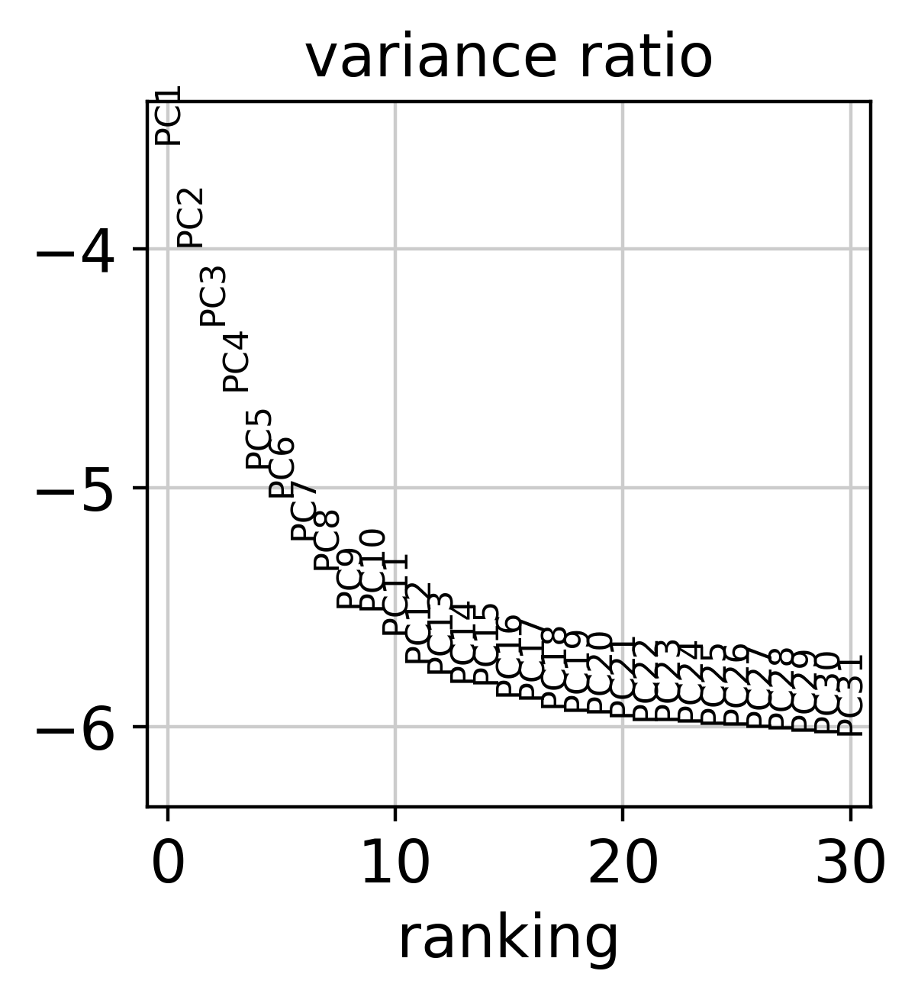

In [31]:
# visualizations
sc.pp.pca(adata_KO_proc, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata_KO_proc, log=True)

In [32]:
sc.pp.neighbors(adata_KO_proc, n_neighbors=30) #, n_pcs = 30, n_neighbors=100, use_rep=None, knn=True, random_state=0, method='umap', metric='euclidean', metric_kwds={}, copy=False

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:02)


In [33]:
sc.tl.tsne(adata_KO_proc, n_jobs=12)
sc.tl.umap(adata_KO_proc)
sc.tl.diffmap(adata_KO_proc)
sc.tl.draw_graph(adata_KO_proc)

computing tSNE
    using 'X_pca' with n_pcs = 50
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9371696  0.9098589  0.8916438  0.8685763  0.8515345
     0.82642096 0.79313856 0.75767773 0.7474161  0.7467438  0.71908486
     0.70747256 0.6924113  0.6803352 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)
drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:00:04)


# 3. Clustering

performing louvain clustering on data using highly variable gnees and n=50 PCs

## 3.1 clustering pouch3

In [34]:
# Perform clustering - using highly variable genes
sc.tl.louvain(adata_pouch3, key_added='louvain_r1')
sc.tl.louvain(adata_pouch3, resolution=0.5, key_added='louvain_r0.5')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 11 clusters and added
    'louvain_r1', the cluster labels (adata.obs, categorical) (0:00:02)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 6 clusters and added
    'louvain_r0.5', the cluster labels (adata.obs, categorical) (0:00:02)


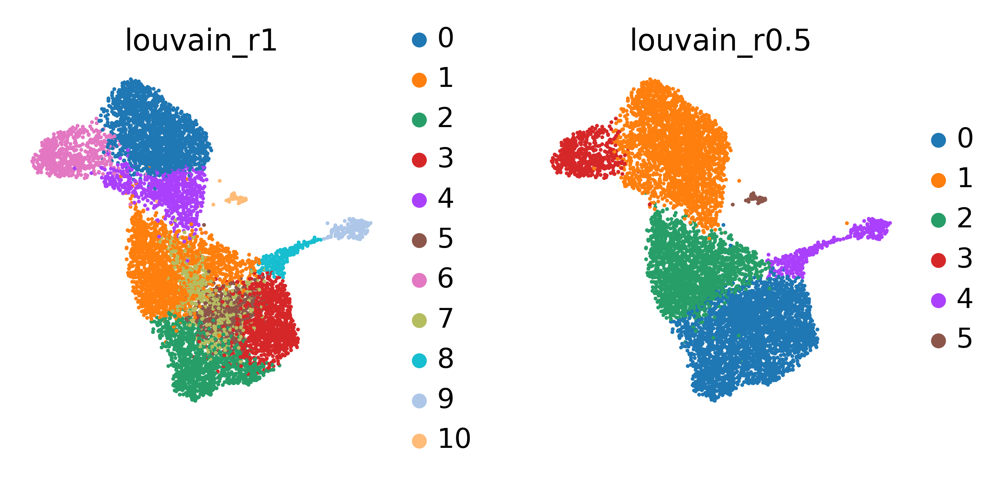

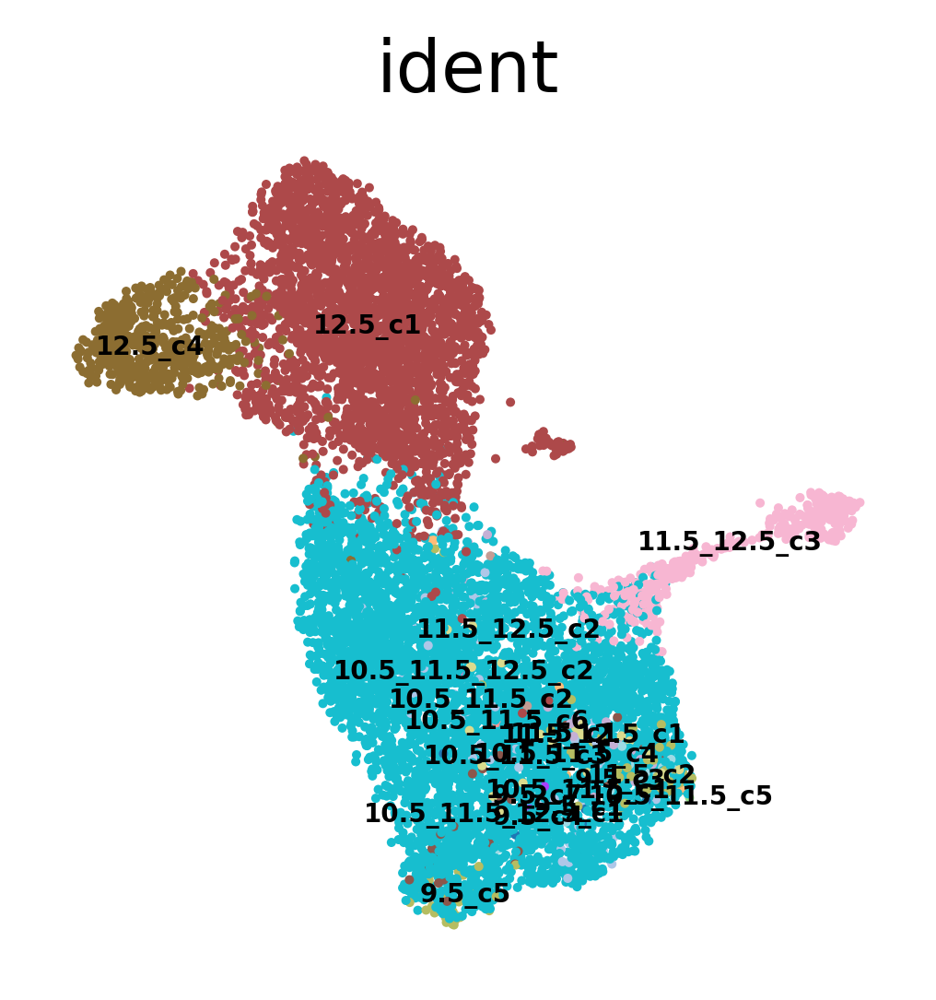

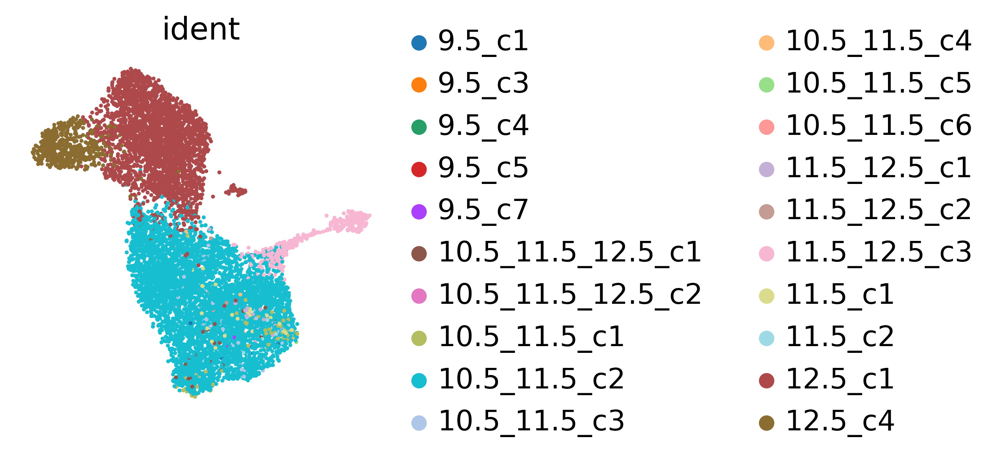

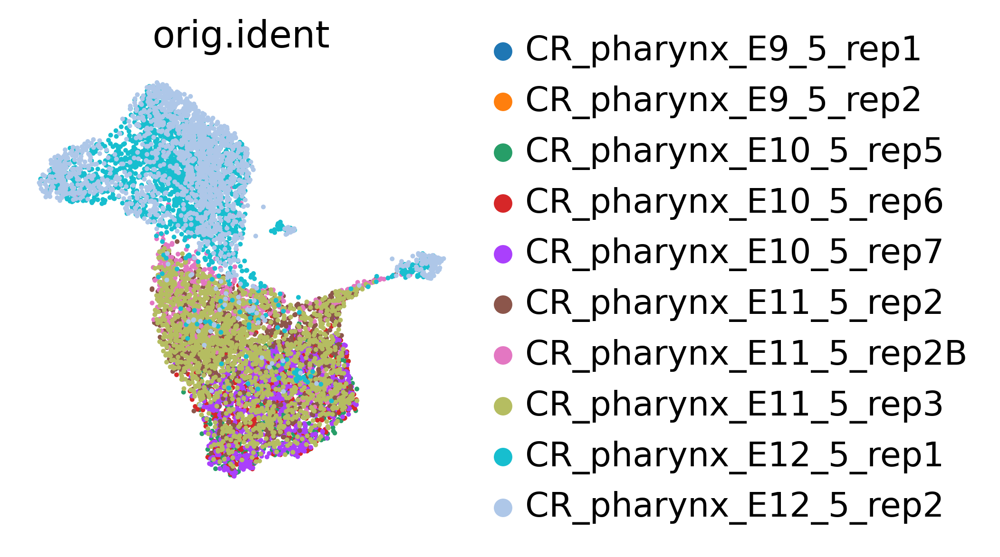

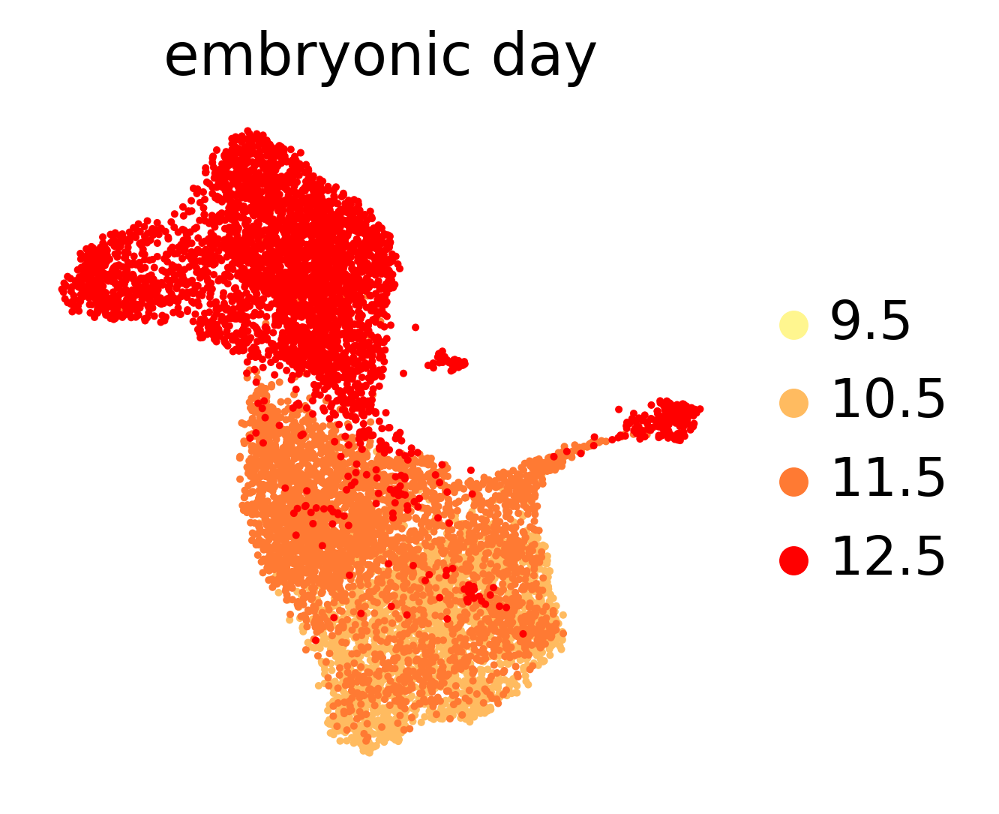

...

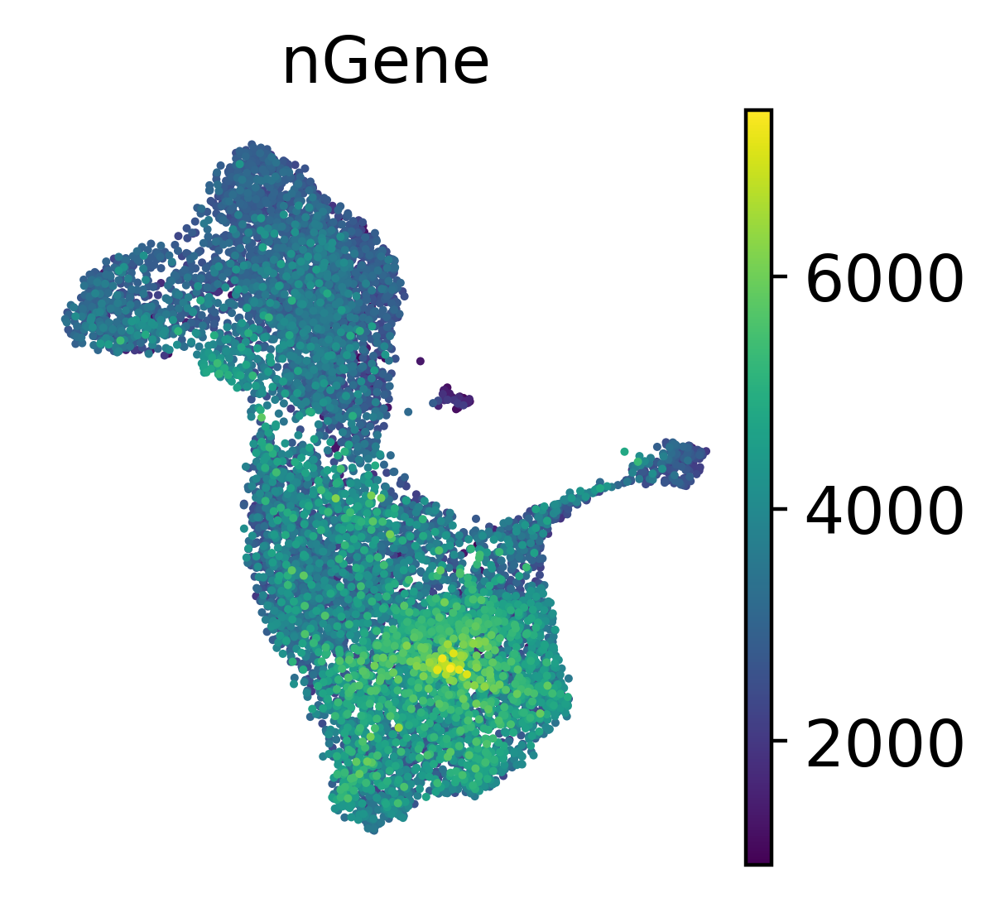

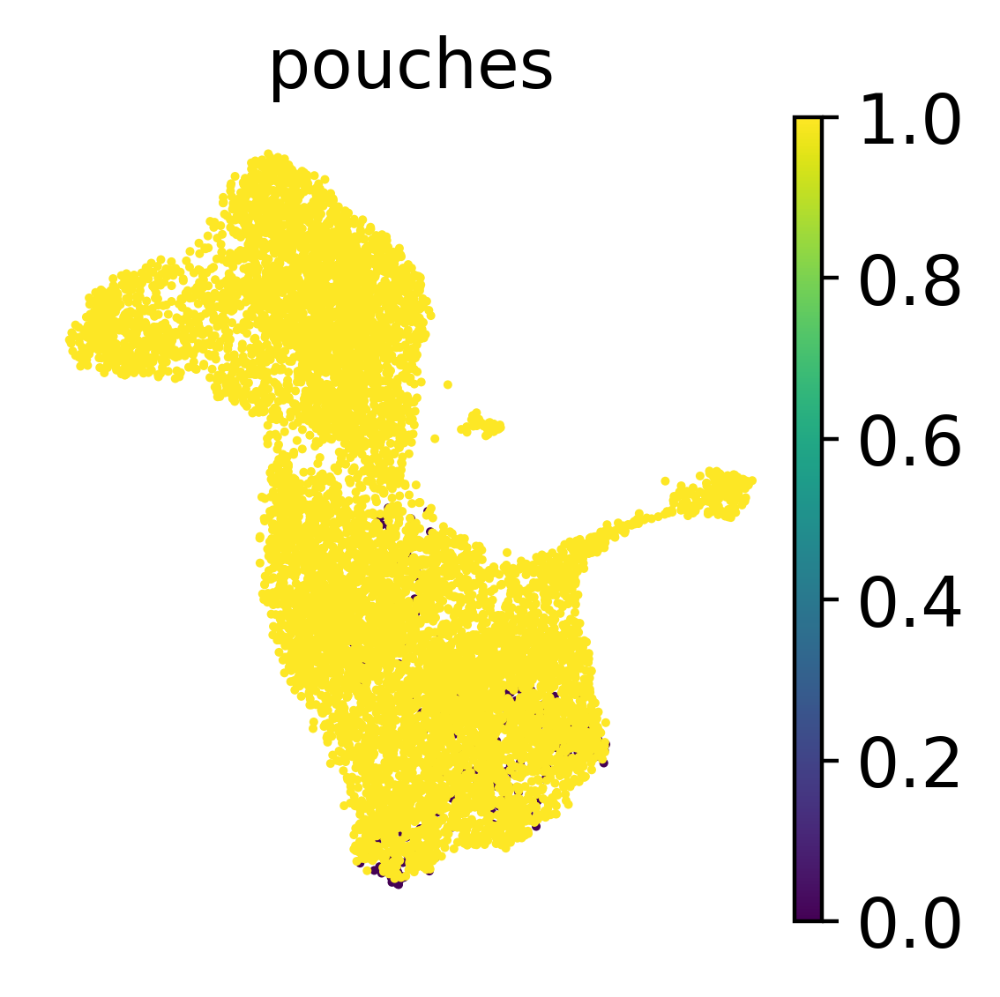

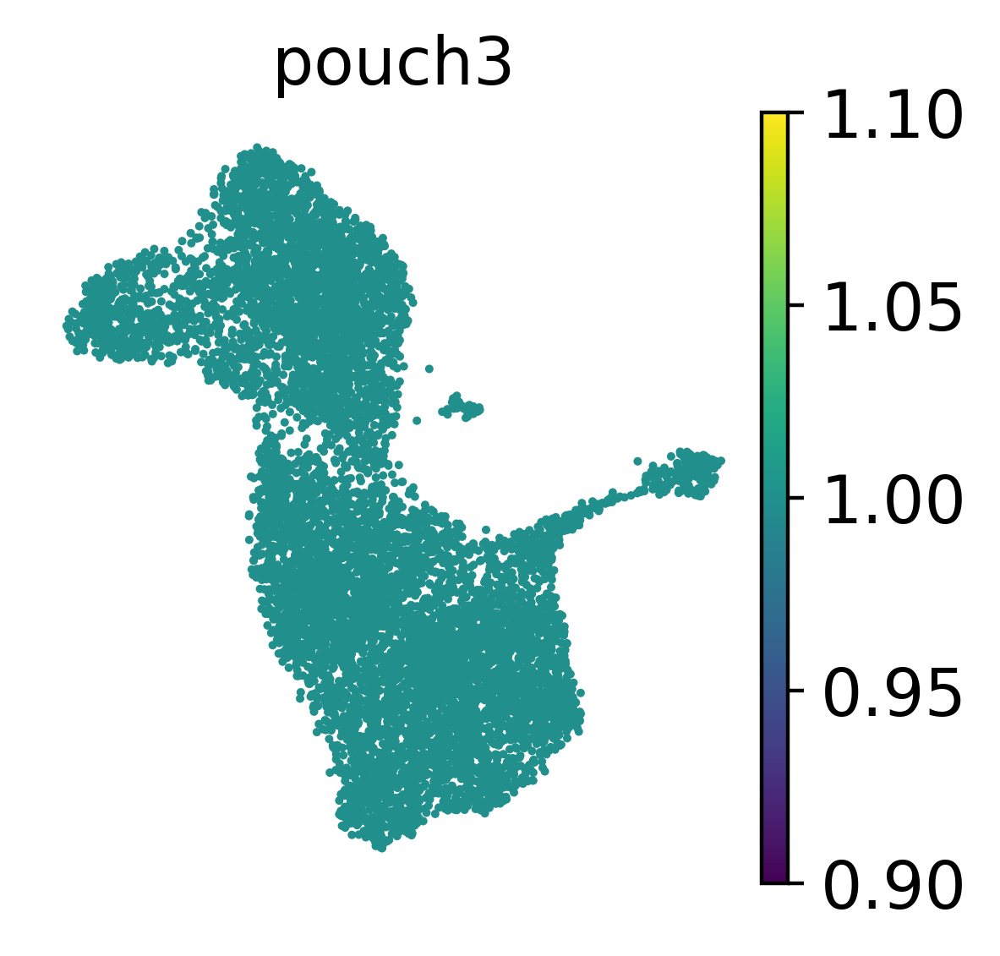

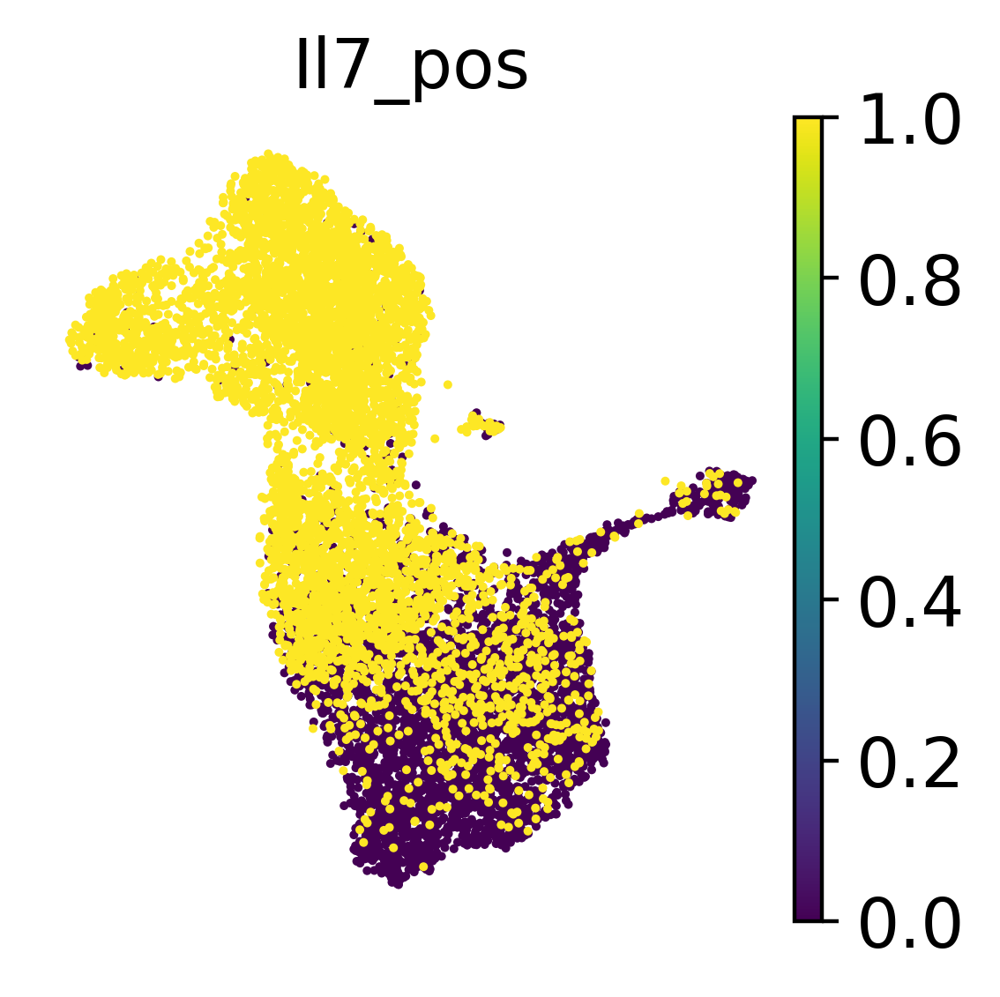

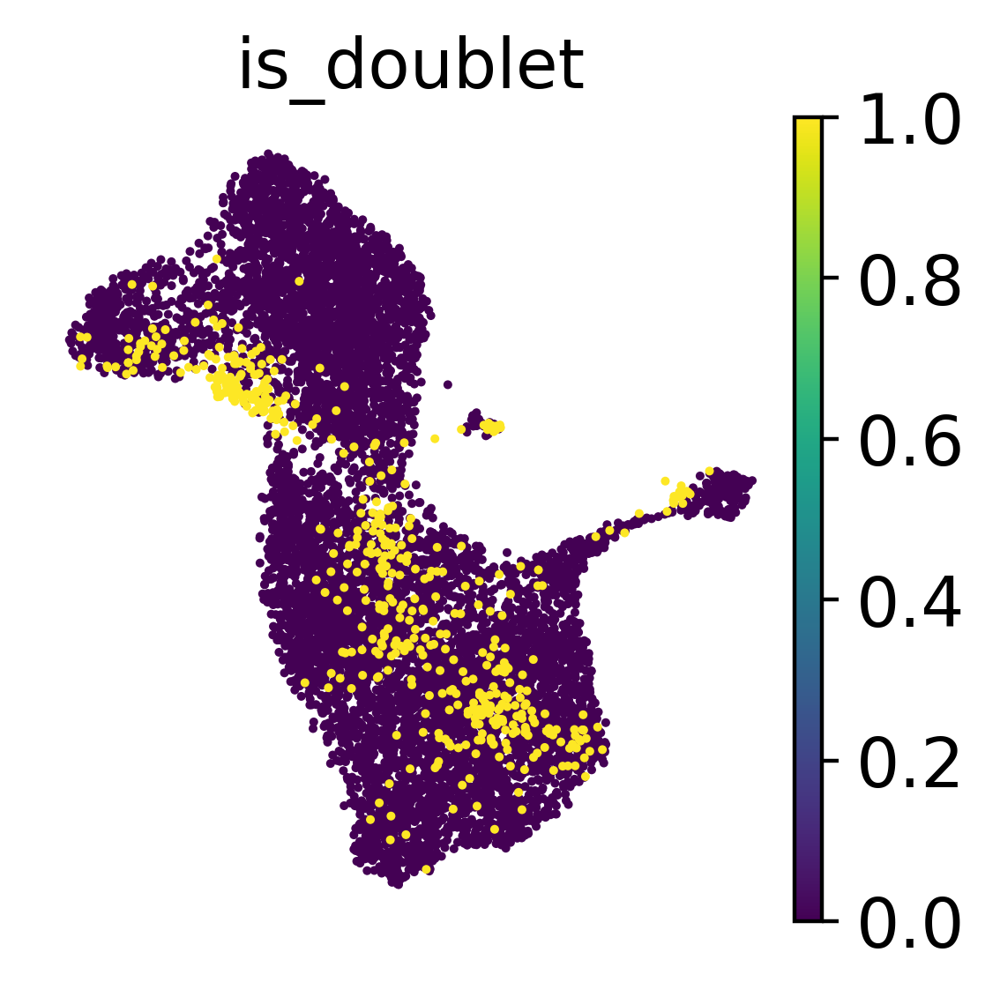

In [35]:
sc.pl.umap(adata_pouch3,color=['louvain_r1','louvain_r0.5'],save="_Louvain_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['ident'], legend_loc='on data', legend_fontsize=5,save="_ident_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['ident'],save="_ident_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['orig.ident'],save="_orig_ident_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['eday'], title=['embryonic day'], save="_day_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['Phase'],save="_phase_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['nUMI'],save="_nUMI_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['log10_nUMI'],save="_log10_nUMI_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['nGene'],save="_nGene_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['pouches'],save="_pouches_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['pouch3'],save="_pouch3_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['Il7_pos'],save="_Il7_pos_3_filtered.pdf")
sc.pl.umap(adata_pouch3,color=['is_doublet'],save="_isDoublet_3_filtered.pdf",palette=['#FF0000','#FFF68F'])

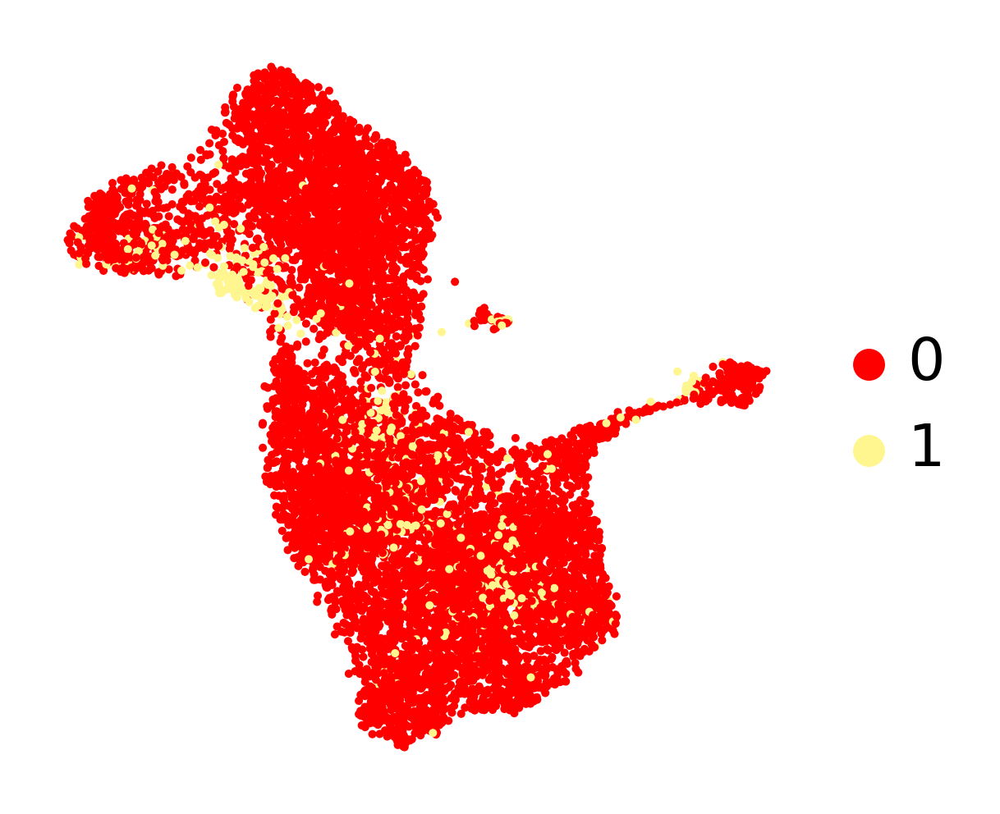

In [37]:
adata_pouch3_with_doublets = adata_pouch3.copy()
adata_pouch3_with_doublets.obs['is_doublet'] = adata_pouch3_with_doublets.obs['is_doublet'].astype('category')
sc.pl.umap(adata_pouch3_with_doublets,color=['is_doublet'],save="_isDoublet_3_filtered.pdf",palette=['#FF0000','#FFF68F'],title='')

In [38]:
# filtering doublets and low quality clusters
adata_pouch3_with_doublets = adata_pouch3.copy()

adata_pouch3_copy = adata_pouch3[adata_pouch3.obs[adata_pouch3.obs['is_doublet'] == 0].index].copy()
adata_pouch3_copy = adata_pouch3_copy[adata_pouch3_copy.obs[adata_pouch3_copy.obs['louvain_r1'] != str(10)].index].copy()

adata_pouch3_no_doublet = adata_pouch3[adata_pouch3_copy.obs_names].copy()
del adata_pouch3_copy

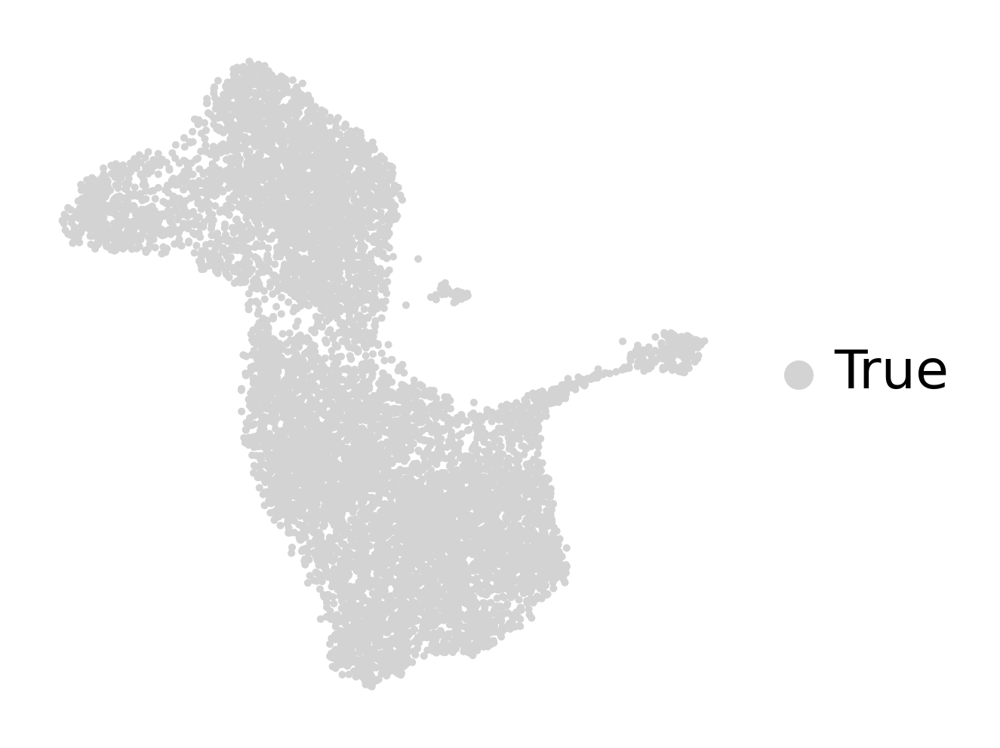

In [39]:
adata_pouch3_with_doublets.obs['nothing'] = True
adata_pouch3_with_doublets.obs['nothing'] = adata_pouch3_with_doublets.obs['nothing'].astype('category')
sc.pl.umap(adata_pouch3_with_doublets,color='nothing',save="_pouch3_with_doublet.pdf",palette=['#D3D3D3'],title='')

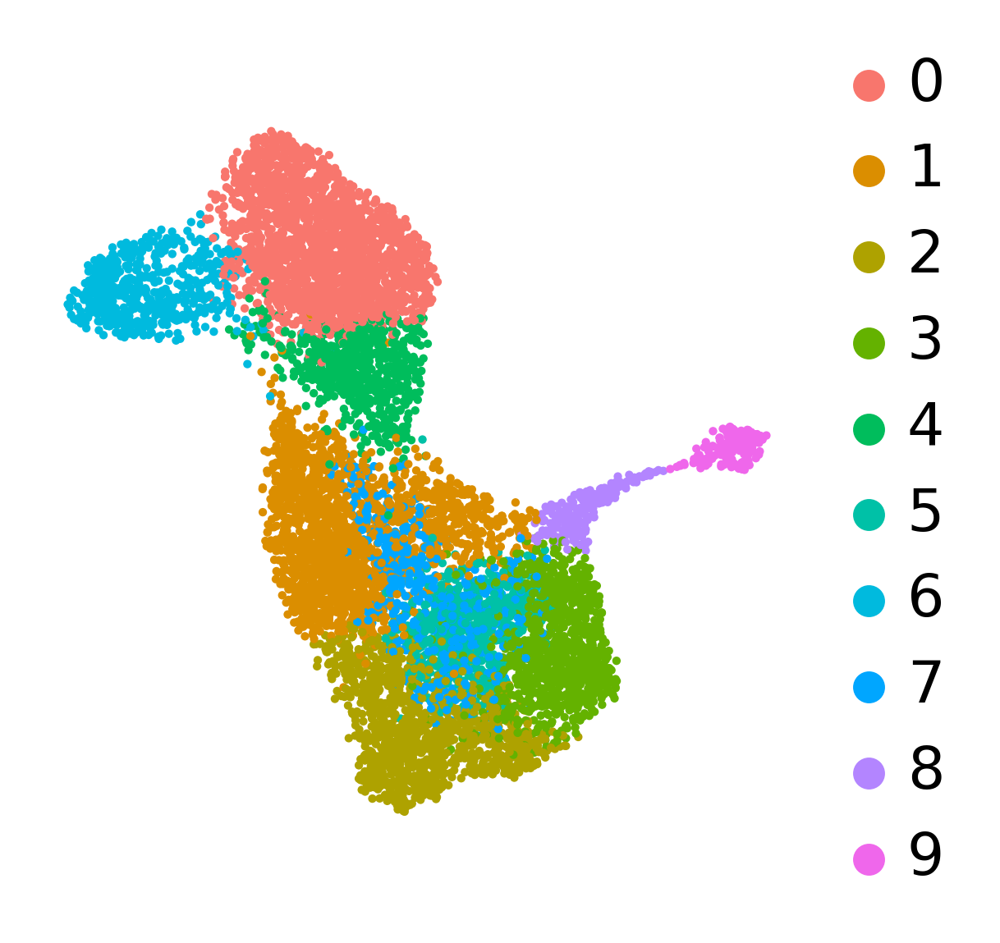

In [40]:
sc.pl.umap(adata_pouch3_no_doublet,color=['louvain_r1'],save="_3_filtered_r1.pdf",title='', palette=["#F8766D","#DB8E00","#AEA200","#64B200","#00BD5C","#00C1A7","#00BADE","#00A6FF","#B385FF","#EF67EB","#FF63B6"])

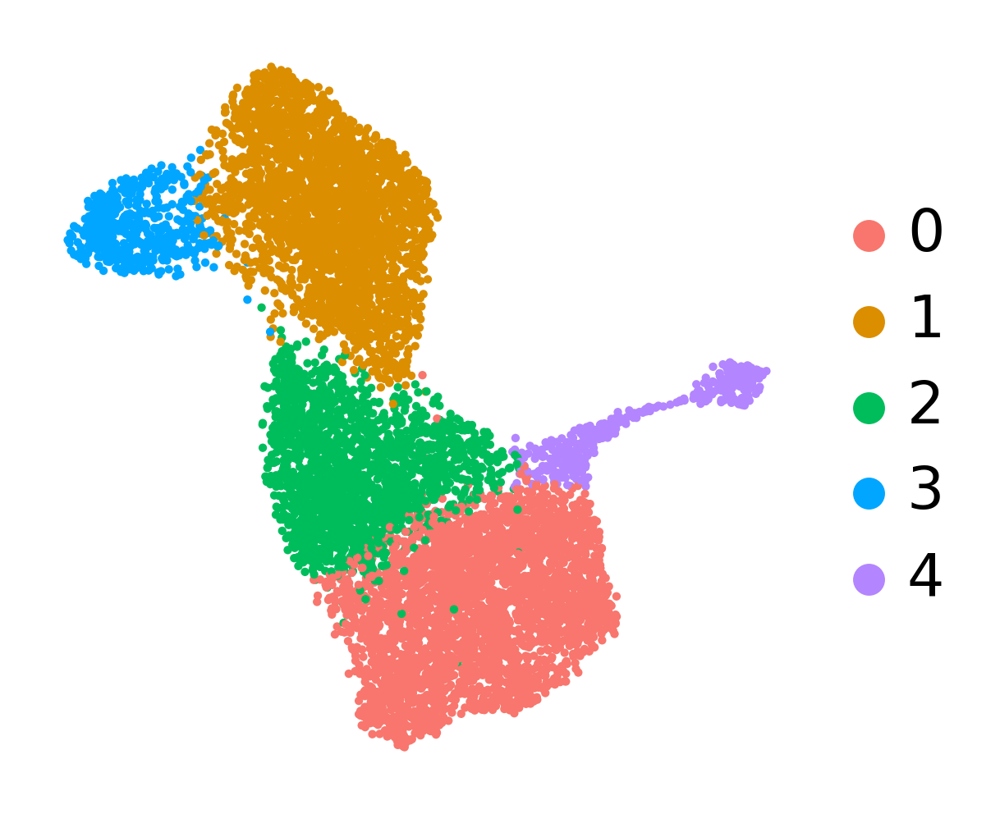

In [41]:
sc.pl.umap(adata_pouch3_no_doublet,color=['louvain_r0.5'],save="_3_filtered_r05.pdf",title='', palette=["#F8766D","#DB8E00","#00BD5C","#00A6FF","#B385FF","#EF67EB","#FF63B6"])

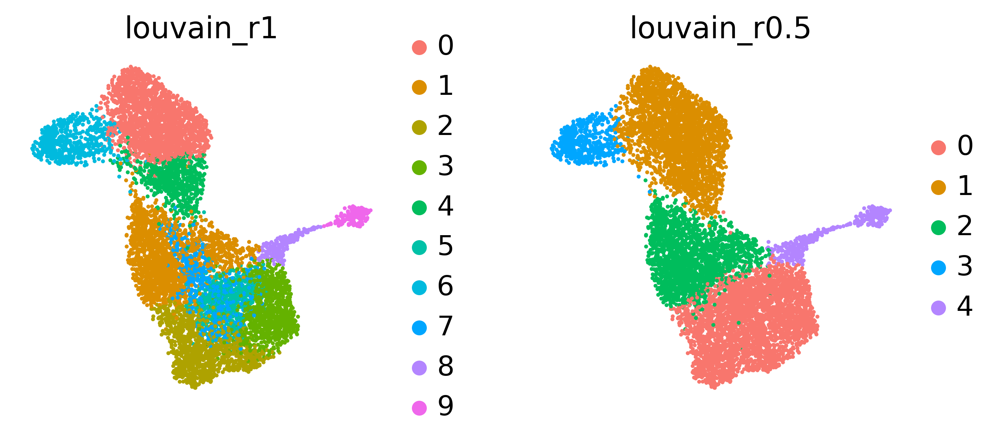

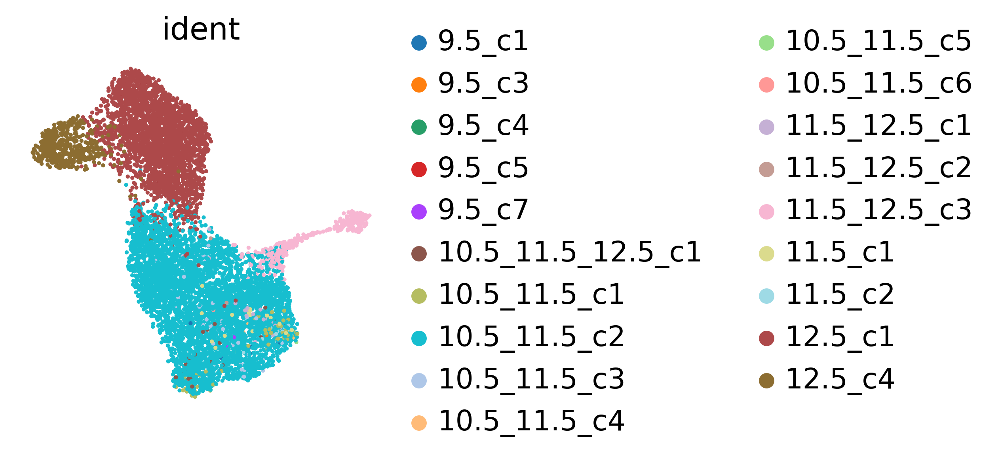

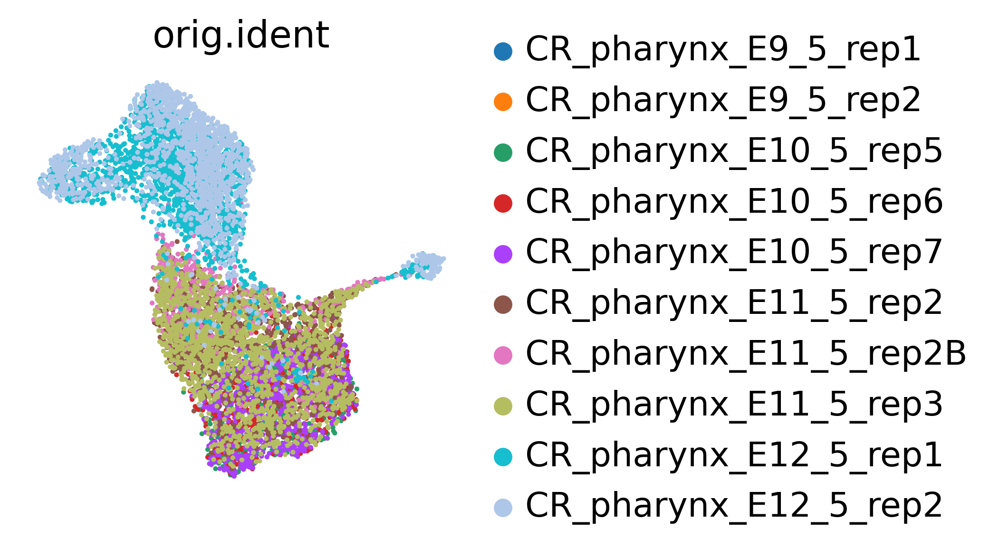

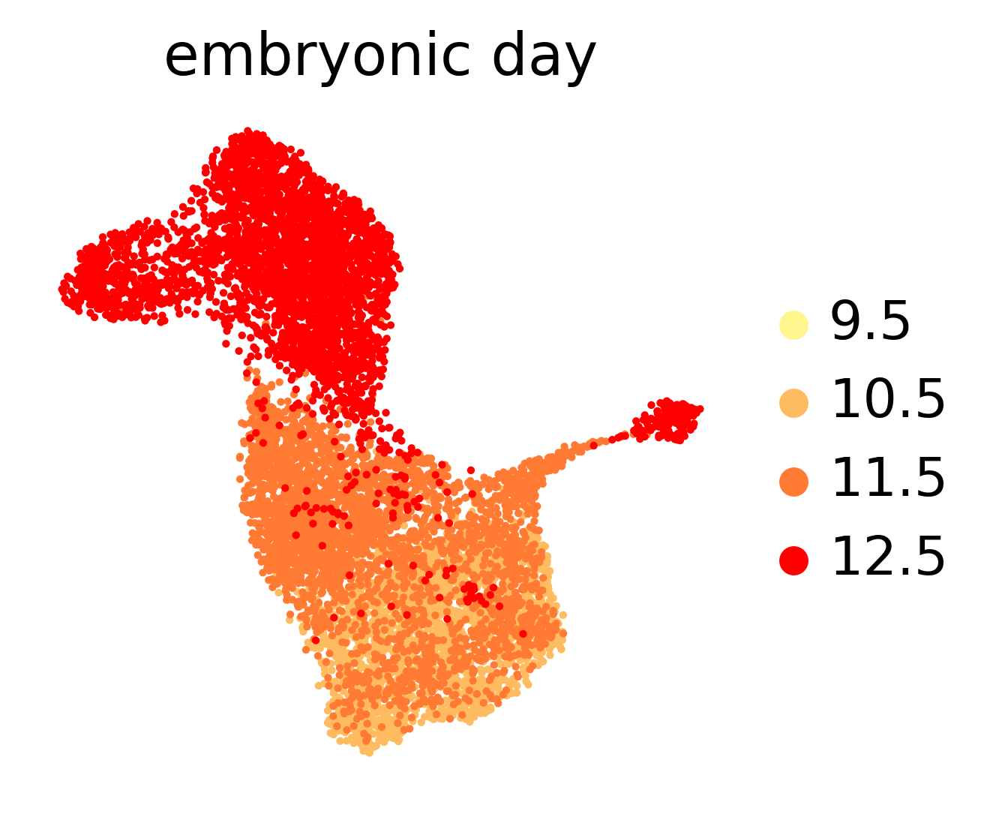

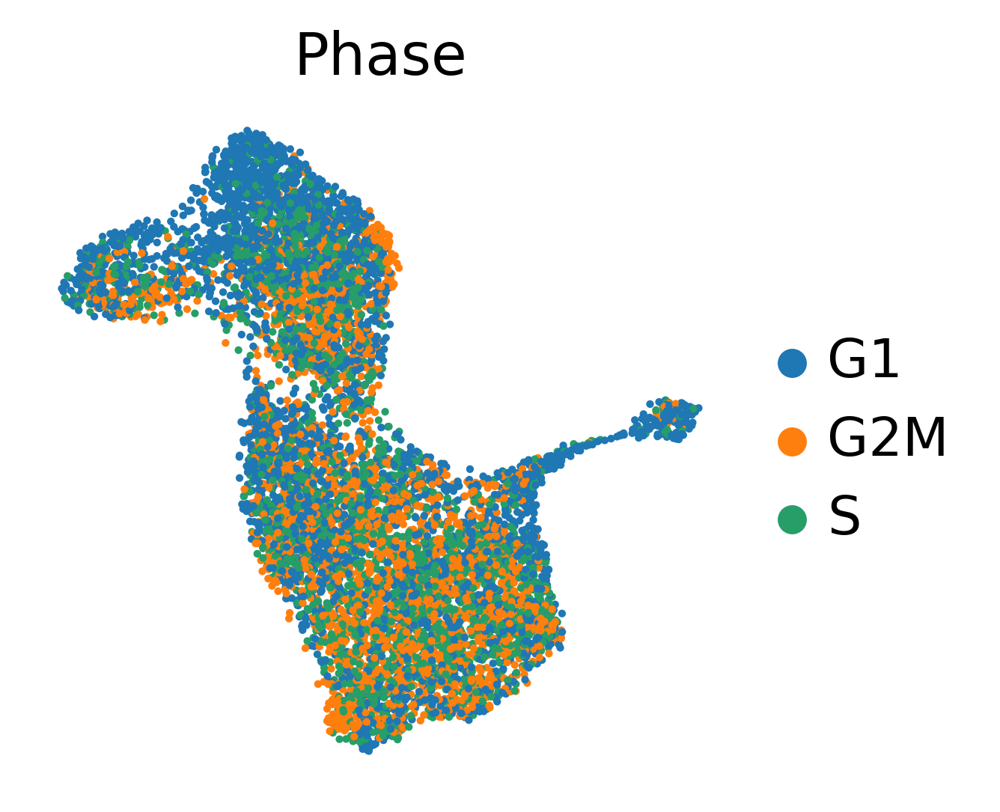

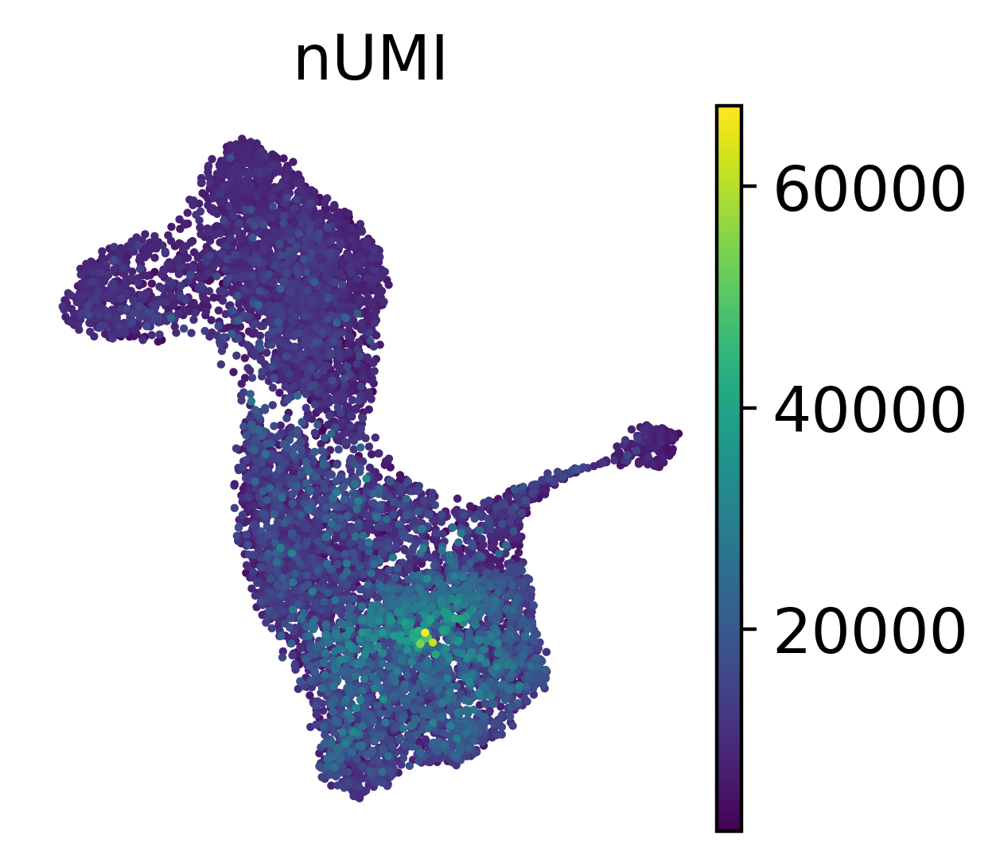

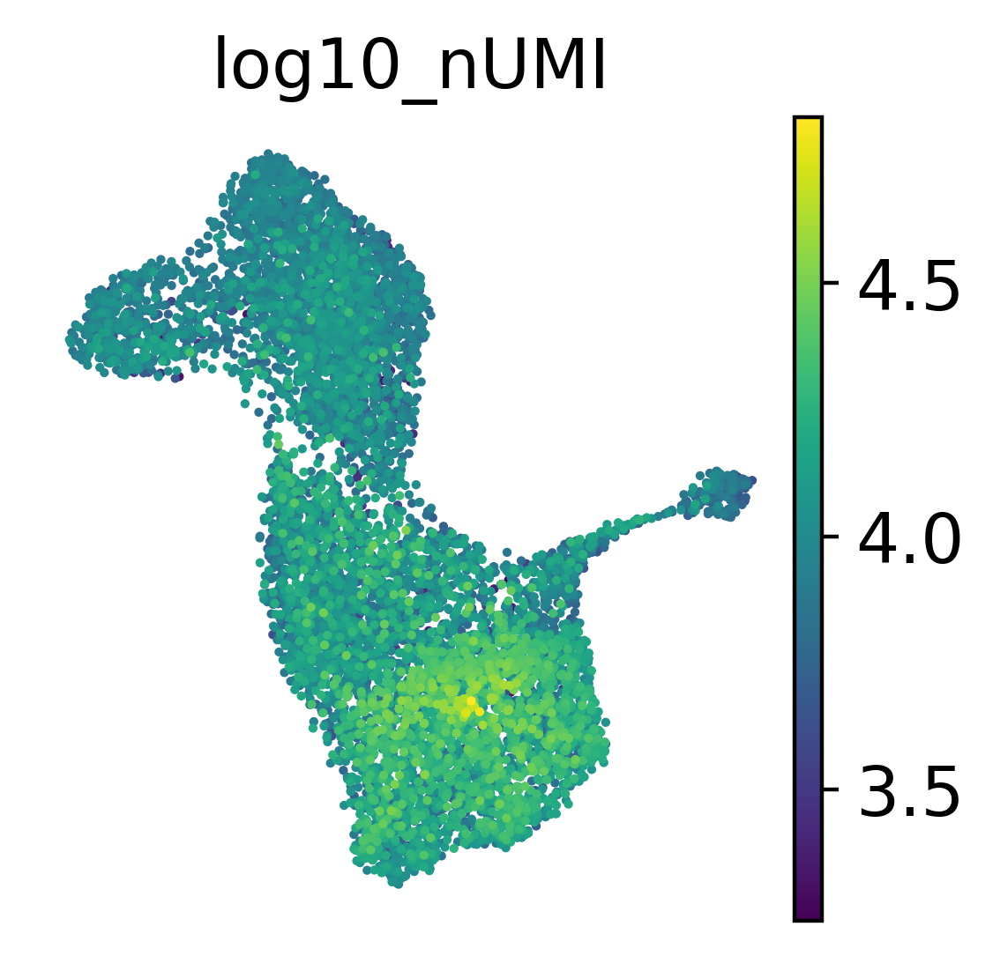

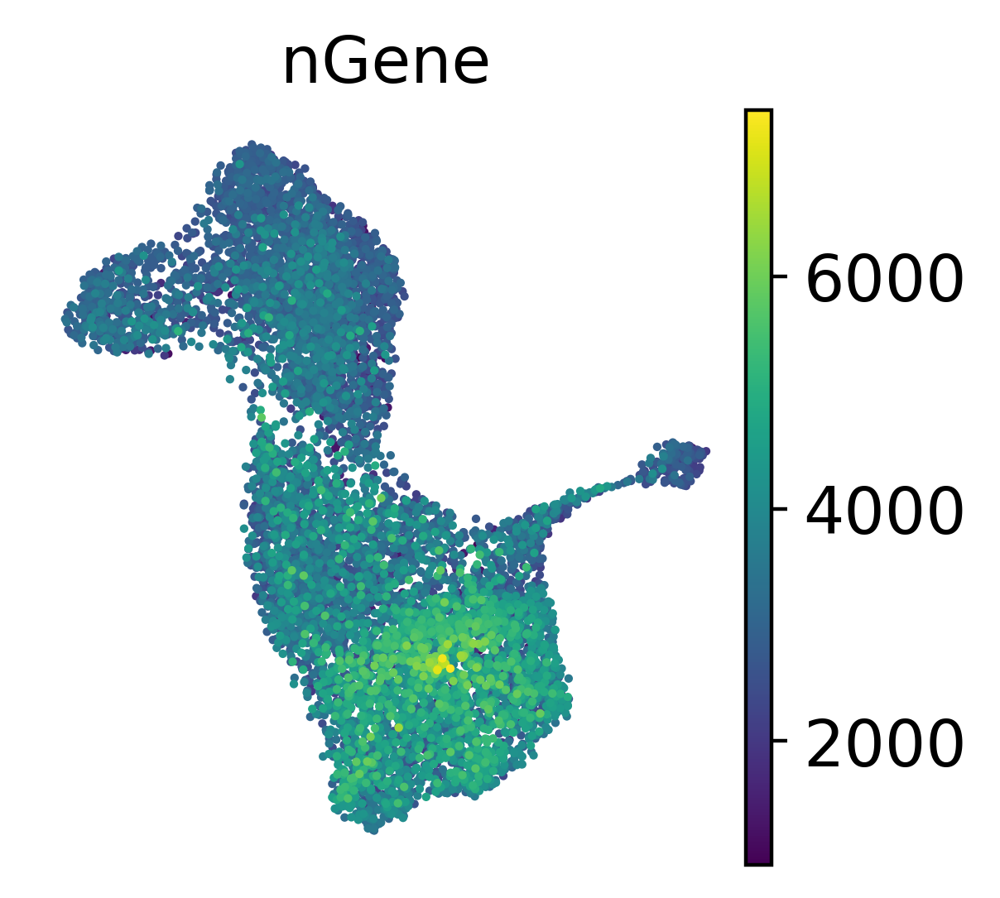

In [42]:
sc.pl.umap(adata_pouch3_no_doublet,color=['louvain_r1','louvain_r0.5'],save="_Louvain_3_filtered.pdf")
sc.pl.umap(adata_pouch3_no_doublet,color=['ident'],save="_ident_3_filtered.pdf")
sc.pl.umap(adata_pouch3_no_doublet,color=['orig.ident'],save="_orig_ident_3_filtered.pdf")
sc.pl.umap(adata_pouch3_no_doublet,color=['eday'], title=['embryonic day'], save="_day_3_filtered.pdf")
sc.pl.umap(adata_pouch3_no_doublet,color=['Phase'],save="_phase_3_filtered.pdf")
sc.pl.umap(adata_pouch3_no_doublet,color=['nUMI'],save="_nUMI_3_filtered.pdf")
sc.pl.umap(adata_pouch3_no_doublet,color=['log10_nUMI'],save="_log10_nUMI_3_filtered.pdf")
sc.pl.umap(adata_pouch3_no_doublet,color=['nGene'],save="_nGene_3_filtered.pdf")

In [45]:
adata_pouch3.write(results_file+"adata_pouch3_ac.h5ad")

In [7]:
adata_pouch3 = sc.read(results_file+"adata_pouch3_ac.h5ad")

# 4. Integrating pouch3 and fox_KO

We used pouch3 samples as the reference data for integration. 
We fit the model on the reference data and the new data (fox_KO) is projected on that. pouch3 and fox_KO matrices are then concatenated for visualisation.

Method description:
* Ingest is a simple PCA-based method for integrating data
* The ingest function assumes an annotated reference dataset that captures the biological variability of interest.
* The rational is to fit a model on the reference data and use it to project new data.
* This model is a PCA combined with a neighbor lookup search tree, for which UMAP’s implementation is used [McInnes18].
* Ingest leaves the data matrix itself invariant.

## 4.1 parametric UMAP using Ingest

In [50]:
adata_KO_proc.obs['fox_KO'] = True
adata_pouch3.obs['fox_KO'] = False

adata_KO_log_norm.obs['fox_KO'] = True
adata_pouch3_log_norm.obs['fox_KO'] = False

In [51]:
adata_proc.obs_names = adata_proc.obs_names.astype(str)

In [52]:
adata_pouch3_log_norm

AnnData object with n_obs × n_vars = 9256 × 27998 
    obs: 'nGene', 'nUMI', 'orig.ident', 'eday', 'nUMI_mt', 'nUMI_rp', 'nUMI_pct_mt', 'nUMI_pct_rp', 'mt_nUMI_pct', 'ribo_nUMI_pct', 'Y_genes', 'res.2', 'ident0', 'ident1', 'ident2', 'ident3', 'ident4', 'ident5', 'ident6', 'ident7', 'ident8', 'ident9', 'ident10', 'ident11', 'ident12', 'ident13', 'ident14', 'ident15', 'ident16', 'ident17', 'ident18', 'ident19', 'ident20', 'ident21', 'ident22', 'ident23', 'ident24', 'ident25', 'ident26', 'ident27', 'ident28', 'ident29', 'ident30', 'ident31', 'ident32', 'ident33', 'ident34', 'ident35', 'ident36', 'ident37', 'ident38', 'ident39', 'ident40', 'ident41', 'ident42', 'S.Score', 'G2M.Score', 'Phase', 'log10_nUMI', 'nUMI_means', 'log10_nUMI_rep_adjusted', 'is_low_quality', 'nUMI_pct_mt_capped', 'pANN', 'pANNPredictions', 'is_doublet', 'XY', 'excess_XY_given_nUMI', 'collagen_total', 'hb_total', 'preliminary_ident', 'included', 'basis_e12', 'basis_e9', 'basis_e10a', 'basis_e10b', 'basis_e11a', 'basi

In [53]:
adata_pouch3.write(results_file+"adata_pouch3_umap.h5ad")
adata_pouch3_log_norm.write(results_file+"adata_pouch3_ln_umap.h5ad")
adata_KO_proc.write(results_file+"adata_KO_umap.h5ad")
adata_KO_log_norm.write(results_file+"adata_KO_ln_umap.h5ad")

... storing 'orig.ident' as categorical
... storing 'Phase' as categorical
... storing 'pANNPredictions' as categorical
... storing 'cluster_name' as categorical
... storing 'terminal_cluster' as categorical
... storing 'eday' as categorical
... storing 'perturbation' as categorical
... storing 'is_ko' as categorical
... storing 'nUMI_mt' as categorical


In [4]:
adata_pouch3 = sc.read(results_file+"adata_pouch3_umap.h5ad")
adata_pouch3_log_norm = sc.read(results_file+"adata_pouch3_ln_umap.h5ad")
adata_KO_proc = sc.read(results_file+"adata_KO_umap.h5ad")
adata_KO_log_norm = sc.read(results_file+"adata_KO_ln_umap.h5ad")

In [54]:
adata_KO_proc = adata_KO_proc[:,adata_pouch3.var_names]

In [55]:
adata_KO_proc.obs['orig.ident'] = adata_KO_proc.obs['eday']
adata_KO_proc.obs['eday'] = adata_KO_proc.obs['sequencing_date']

Trying to set attribute `.obs` of view, copying.


In [56]:
adata_pouch3.obs['is_ko'] = 'pouch3'
adata_pouch3_log_norm.obs['is_ko'] = 'pouch3'

In [57]:
adata_KO_log_norm = adata_KO_log_norm[adata_KO_proc.obs_names]
adata_KO_log_norm.obs['is_ko'] = adata_KO_proc.obs['is_ko']

Trying to set attribute `.obs` of view, copying.


In [58]:
#removing doublets
adata_pouch3 = adata_pouch3[adata_pouch3_no_doublet.obs_names]
sc.pp.neighbors(adata_pouch3, n_neighbors=30)
adata_pouch3_log_norm = adata_pouch3_log_norm[adata_pouch3_no_doublet.obs_names]

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:11)


In [59]:
ing = sc.tl.Ingest(adata_pouch3)
ing.fit(adata_KO_proc)
ing.map_embedding('pca')
ing.map_embedding('umap')
ing.neighbors(k=10)

pouch3_cells_ingest = ing._indices#here are top k neighbors

ing.map_labels('louvain_r0.5', method='knn')
adata_KO_proc = ing.to_adata(inplace=False)
adata_both = ing.to_adata_joint()

In [60]:
sc.set_figure_params(dpi=200, dpi_save=300, vector_friendly=True, frameon=False)

In [61]:
mpl.rcParams['figure.figsize'] = (3, 3)

In [62]:
adata_both

AnnData object with n_obs × n_vars = 9890 × 27998 
    obs: 'G2M.Score', 'Il7_pos', 'Il7pos', 'Phase', 'S.Score', 'UMAP1', 'UMAP2', 'Unnamed: 52', 'Y_genes', 'barcode', 'batch', 'classifier_ident', 'classifier_probs_0', 'classifier_probs_1', 'classifier_probs_10', 'classifier_probs_11', 'classifier_probs_12', 'classifier_probs_13', 'classifier_probs_14', 'classifier_probs_15', 'classifier_probs_16', 'classifier_probs_17', 'classifier_probs_18', 'classifier_probs_19', 'classifier_probs_2', 'classifier_probs_20', 'classifier_probs_21', 'classifier_probs_22', 'classifier_probs_23', 'classifier_probs_24', 'classifier_probs_25', 'classifier_probs_26', 'classifier_probs_27', 'classifier_probs_3', 'classifier_probs_4', 'classifier_probs_5', 'classifier_probs_6', 'classifier_probs_7', 'classifier_probs_8', 'classifier_probs_9', 'cluster', 'cluster_name', 'day_str', 'eday', 'fox_KO', 'ident', 'included', 'is_doublet', 'is_ko', 'log10_nUMI', 'louvain_r0.5', 'louvain_r1', 'mt_nUMI_pct', 'nGene', 

In [63]:
#remove the batch indices added by ingest to the obs_names
adata_both.obs_names = [x[:-2] for x in adata_both.obs_names]

In [64]:
adata_both.write(results_file+"adata_both.h5ad")

... storing 'Phase' as categorical
... storing 'barcode' as categorical
... storing 'cluster_name' as categorical
... storing 'day_str' as categorical
... storing 'ident' as categorical
... storing 'is_ko' as categorical
... storing 'louvain_r0.5' as categorical
... storing 'louvain_r1' as categorical
... storing 'nUMI_mt' as categorical
... storing 'orig.ident' as categorical
... storing 'perturbation' as categorical


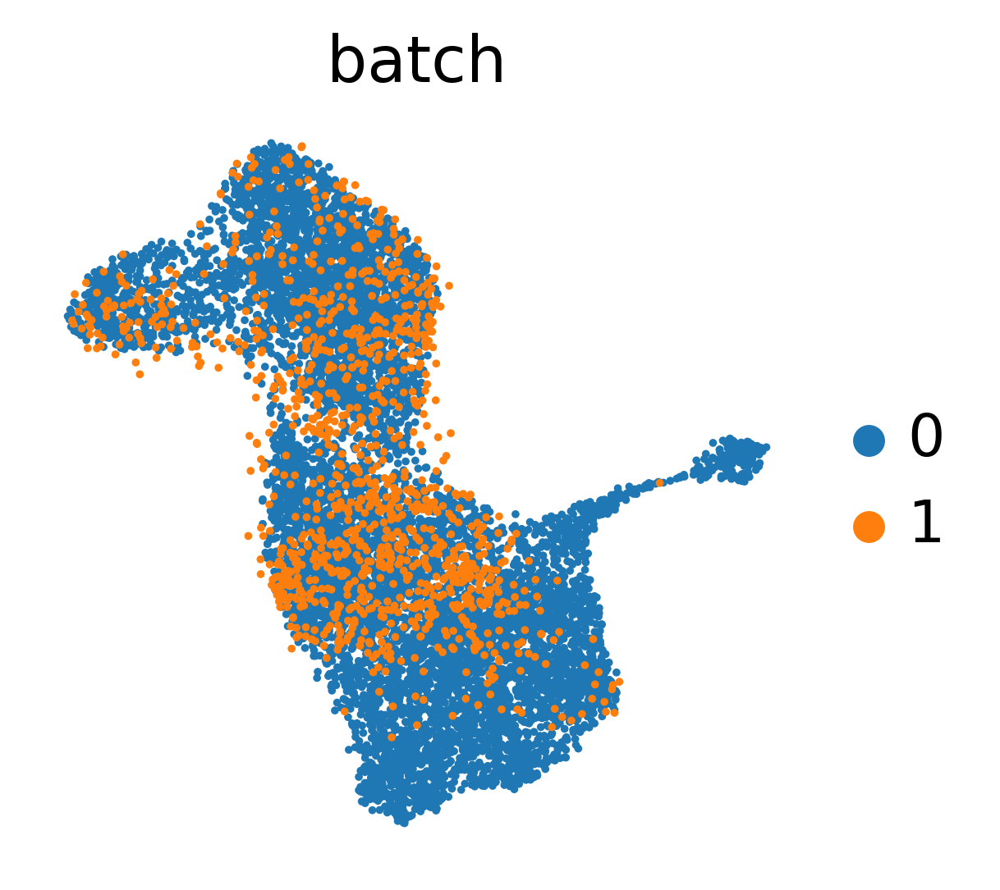

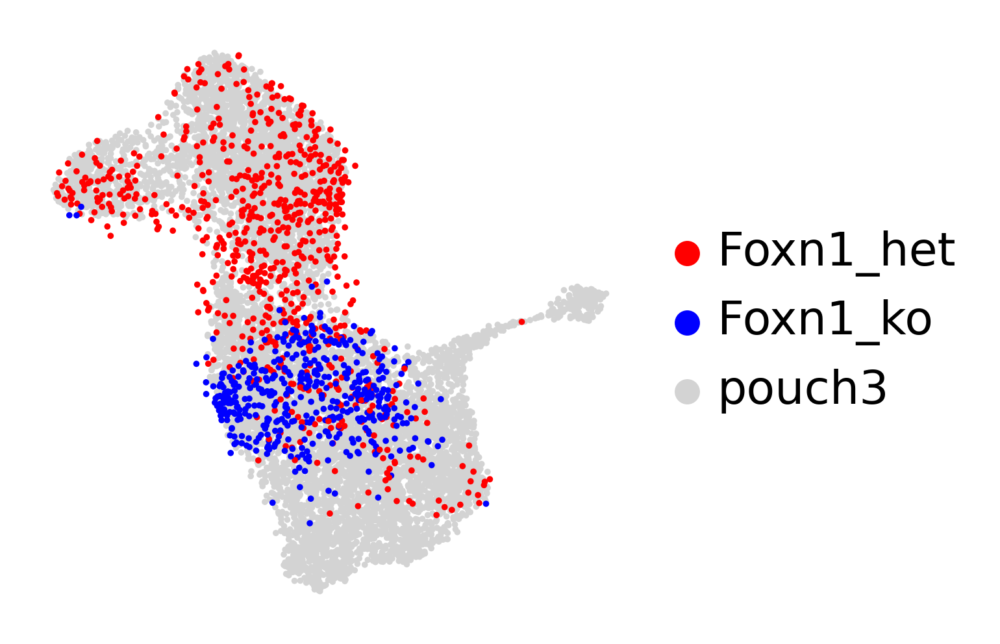

In [65]:
sc.pl.umap(adata_both,color='batch',save="_both_batch.pdf")
sc.pl.umap(adata_both,color='is_ko',palette=['red','blue','#D3D3D3'],title='',save="_both_genotype.pdf")

In [66]:
from scipy.sparse import csr_matrix
#adata_KO_log_norm.X = adata_KO_log_norm.X.todense()
adata_pouch3_log_norm.X = adata_pouch3_log_norm.X.todense()

In [71]:
adata_pouch3_log_norm.X

<8717x27998 sparse matrix of type '<class 'numpy.float32'>'
	with 29007906 stored elements in Compressed Sparse Row format>

In [72]:
X_concat2 = np.concatenate([adata_pouch3_log_norm.X.todense(),adata_KO_log_norm.X], axis=0)
adata_both_log_norm = sc.AnnData(X_concat2)
adata_both_log_norm.var_names = adata_pouch3.var_names
adata_both_log_norm.var['highly_variable'] = adata_pouch3.var['highly_variable']

In [73]:
adata_both_log_norm.obs = pd.concat([adata_pouch3.obs.loc[:,['eday','orig.ident','is_ko','nUMI','louvain_r0.5']],adata_KO_proc.obs.loc[:,['eday','orig.ident','is_ko','nUMI','louvain_r0.5']]])

In [74]:
adata_both_log_norm = adata_both_log_norm[adata_both.obs_names].copy()
adata_both_log_norm.obs.shape

(9890, 5)

In [75]:
#adata_pouch3 = adata_pouch3[adata_pouch3_no_doublet.obs_names]
#sc.pp.neighbors(adata_pouch3, n_neighbors=30) #re-cal the neighbor graph because of the cells removal
#adata_pouch3_log_norm = adata_pouch3_log_norm[adata_pouch3_no_doublet.obs_names]

... storing 'is_ko' as categorical


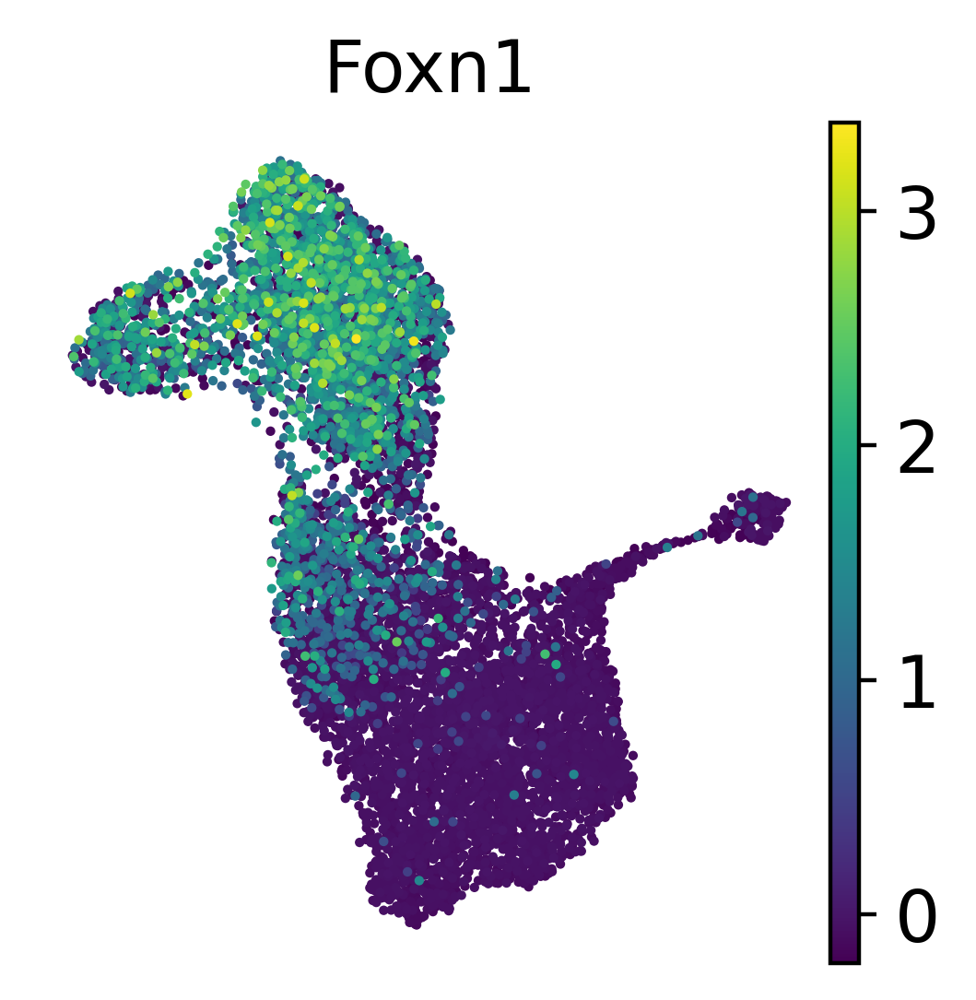

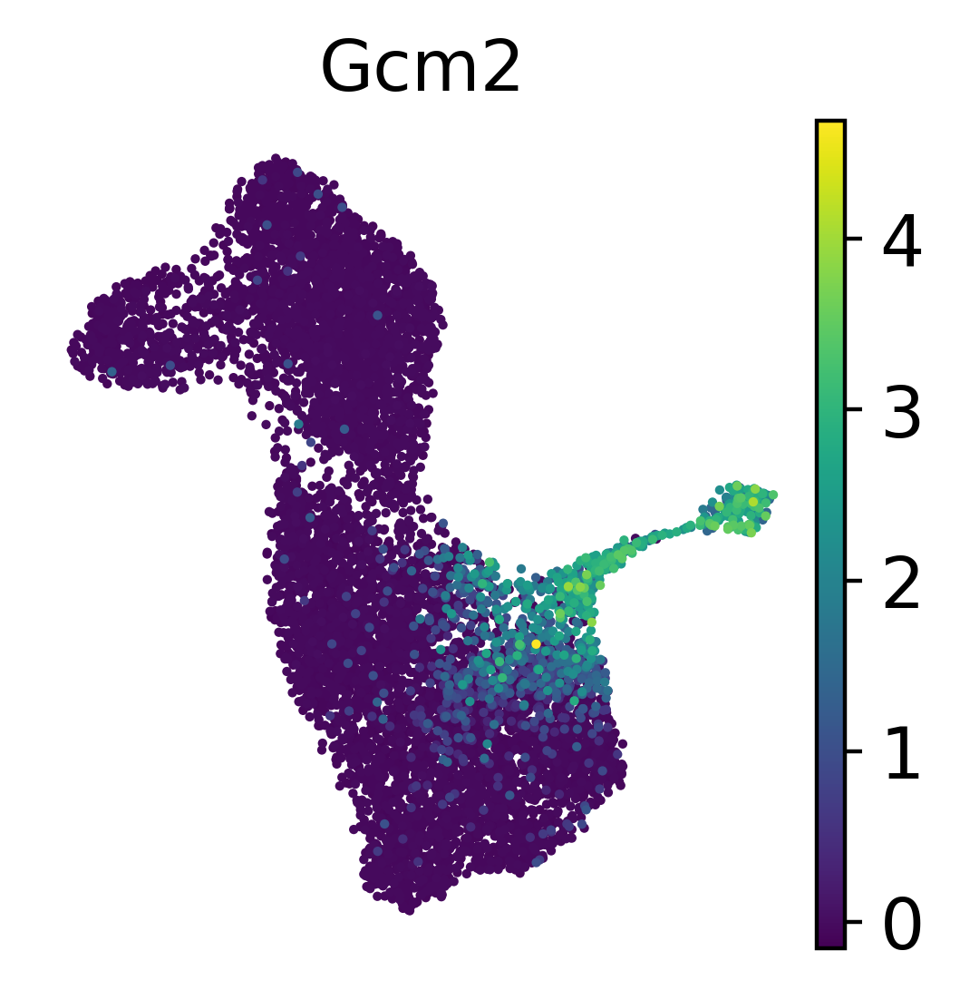

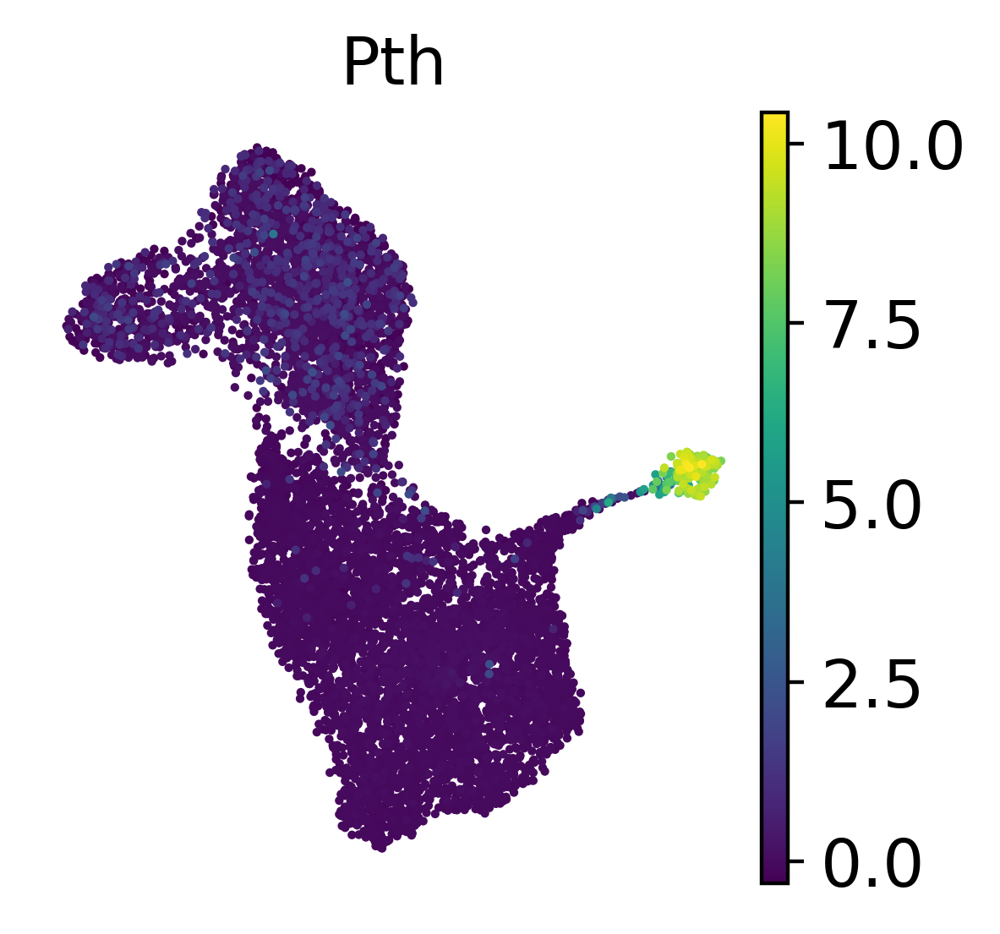

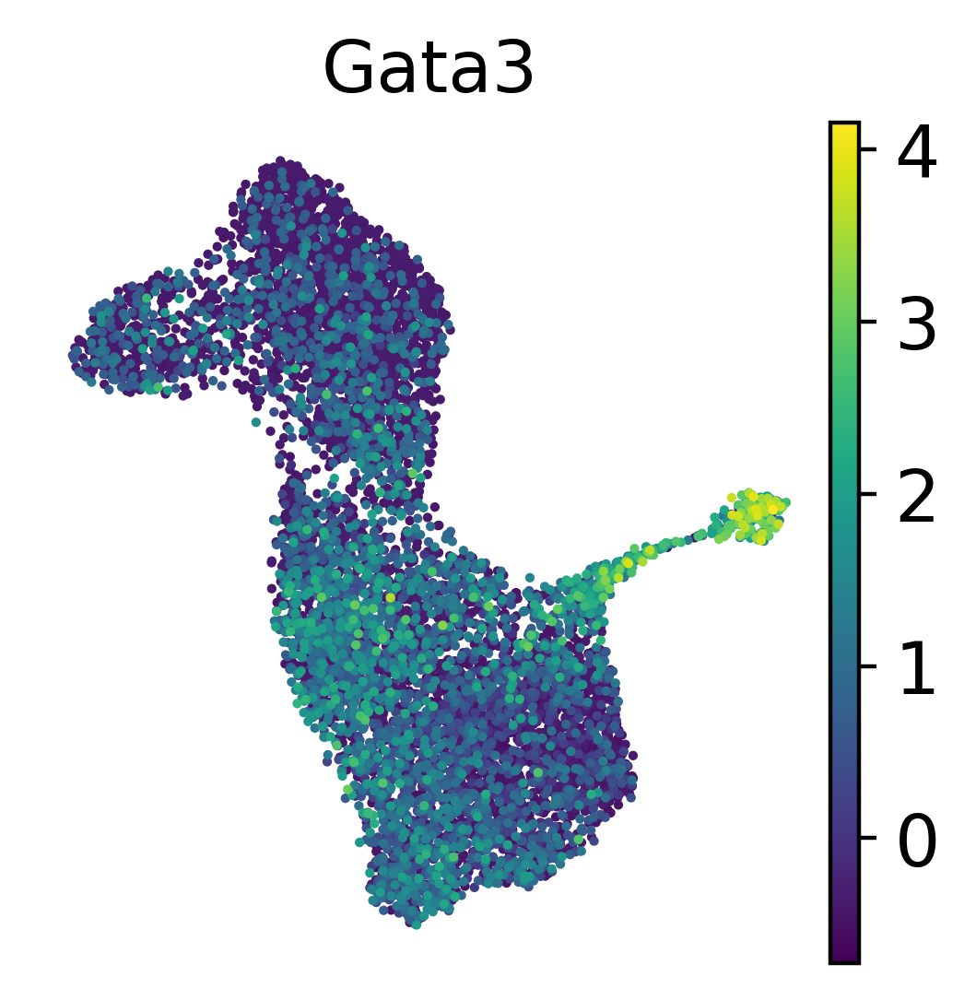

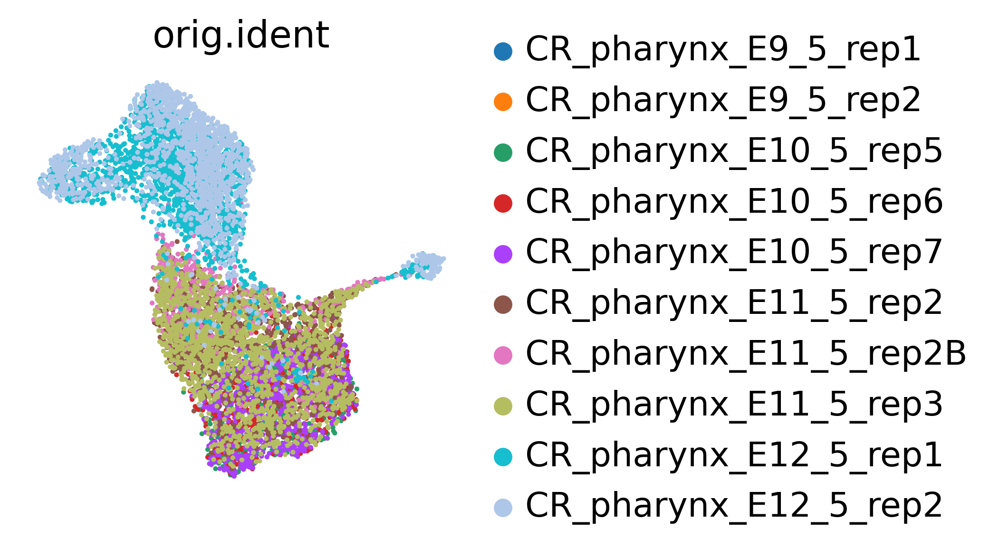

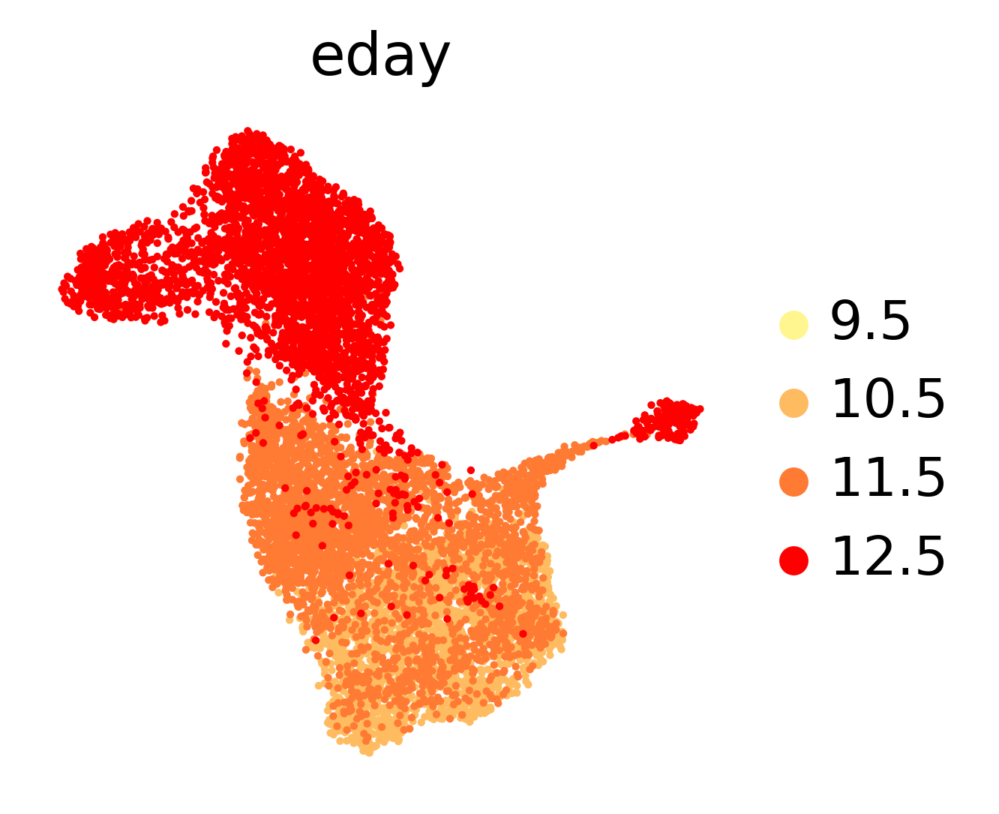

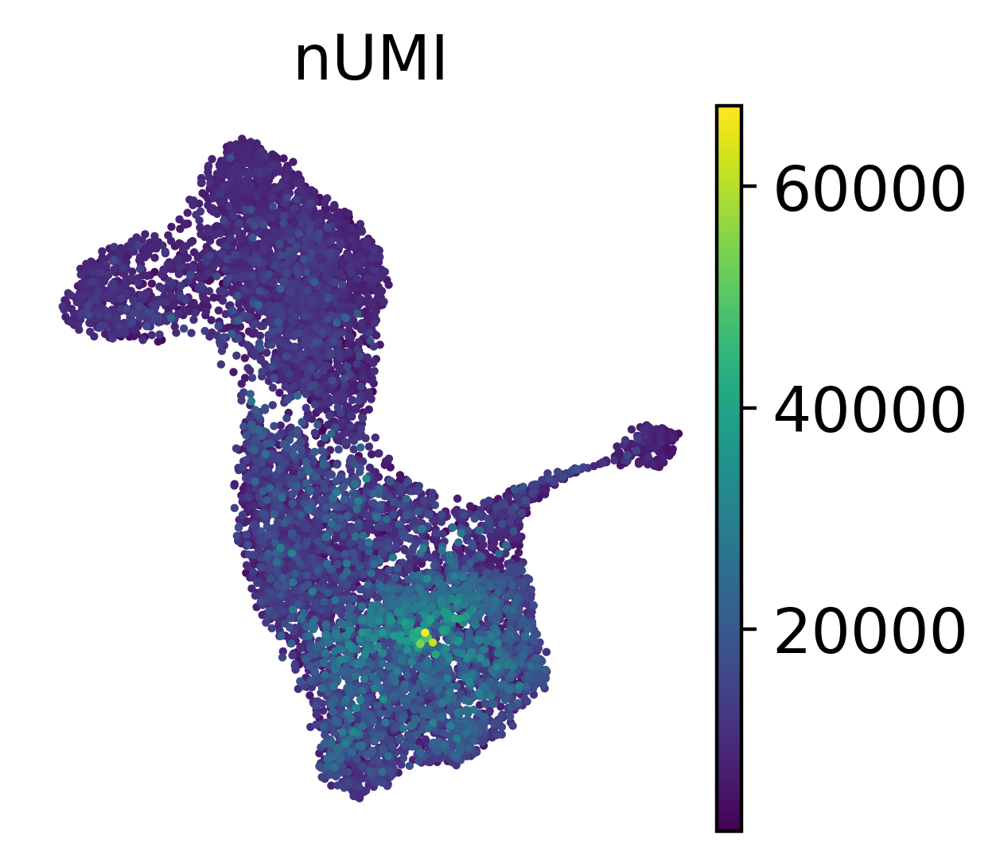

In [76]:
sc.pl.umap(adata_pouch3, color='Foxn1',save="_pouch3_Foxn1.pdf")
sc.pl.umap(adata_pouch3, color='Gcm2',save="_pouch3_Gcm2.pdf")
sc.pl.umap(adata_pouch3, color='Pth',save="_pouch3_Pth.pdf")
sc.pl.umap(adata_pouch3, color='Gata3',save="_pouch3_Gata3.pdf")
sc.pl.umap(adata_pouch3, color='orig.ident',save="_pouch3_orig_ident.pdf")
sc.pl.umap(adata_pouch3, color='eday',save="_pouch3_eday.pdf")
sc.pl.umap(adata_pouch3, color='nUMI',save="_pouch3_nUMI.pdf")

In [77]:
adata_both.obs['ident_2'] = 'pouch3'
adata_KO_proc
for x in adata_both.obs[adata_both.obs['is_ko'].isin(['Foxn1_ko', 'Foxn1_het'])].index:
    adata_both.obs.loc[x,'ident_2']=adata_KO_log_norm.obs.loc[x,'eday']


... storing 'ident_2' as categorical


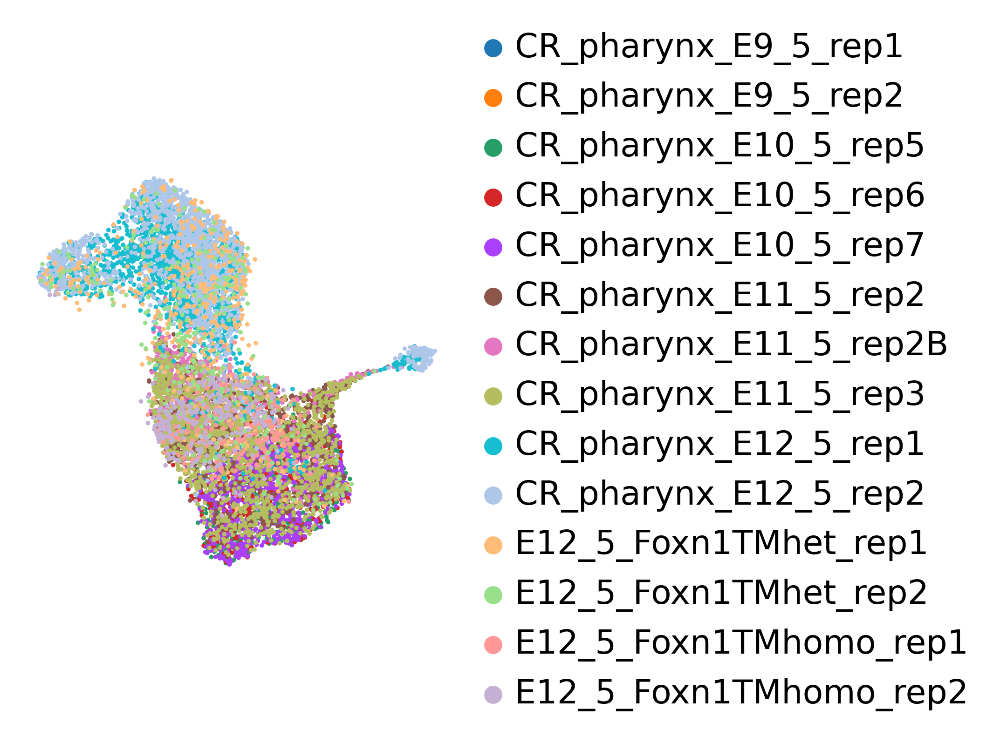

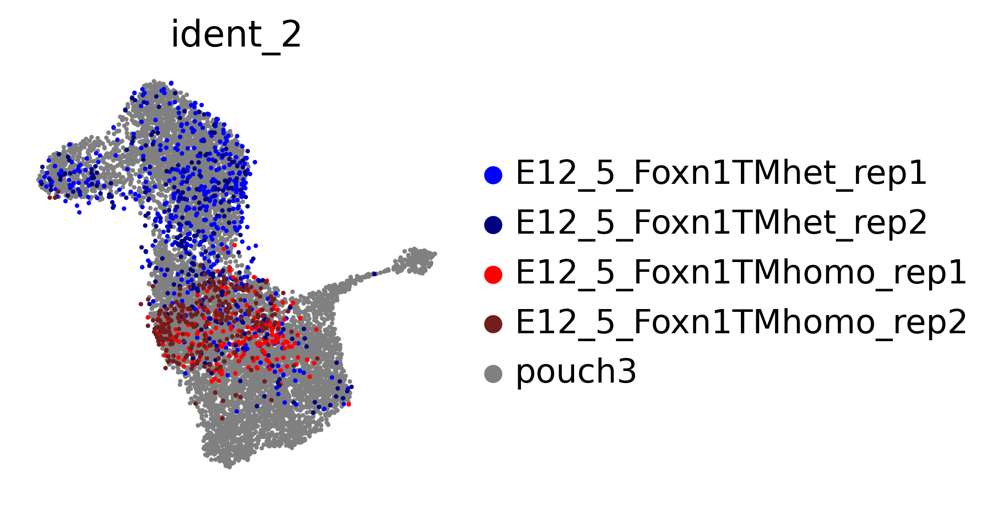

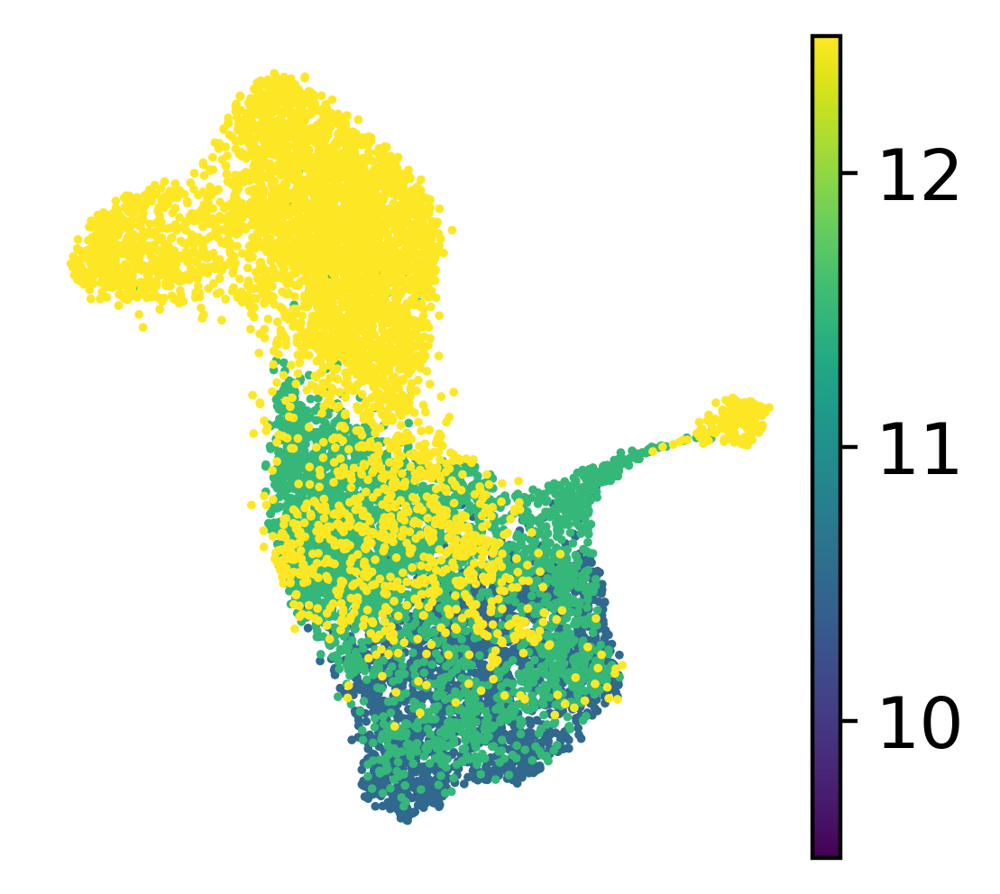

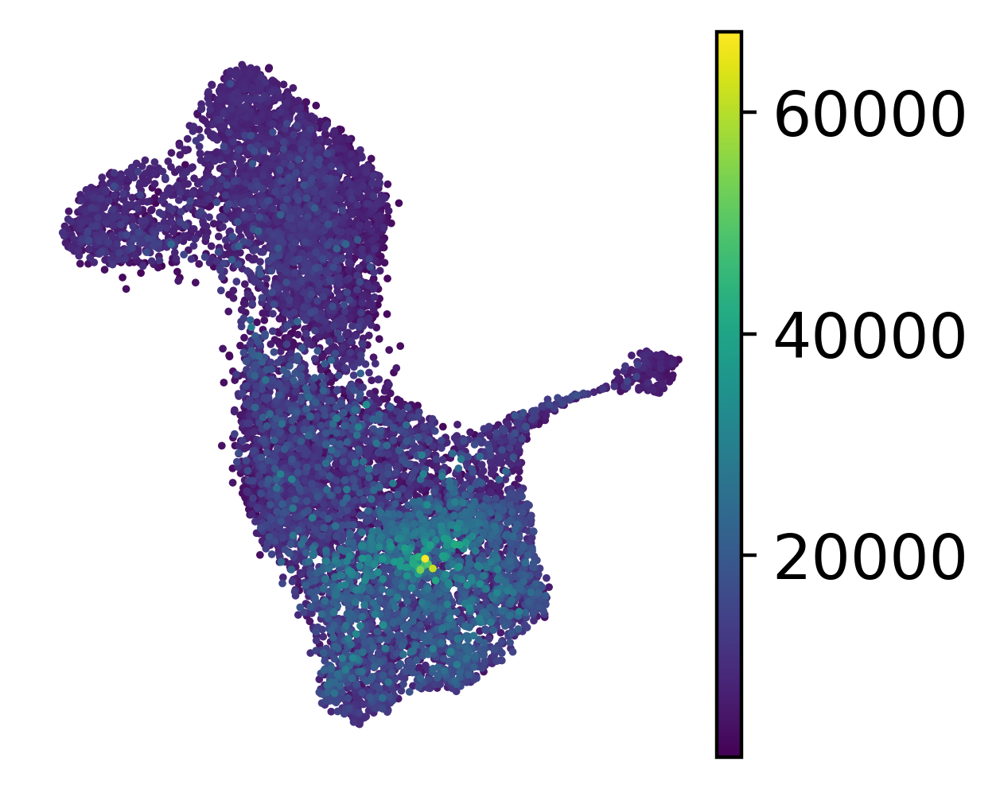

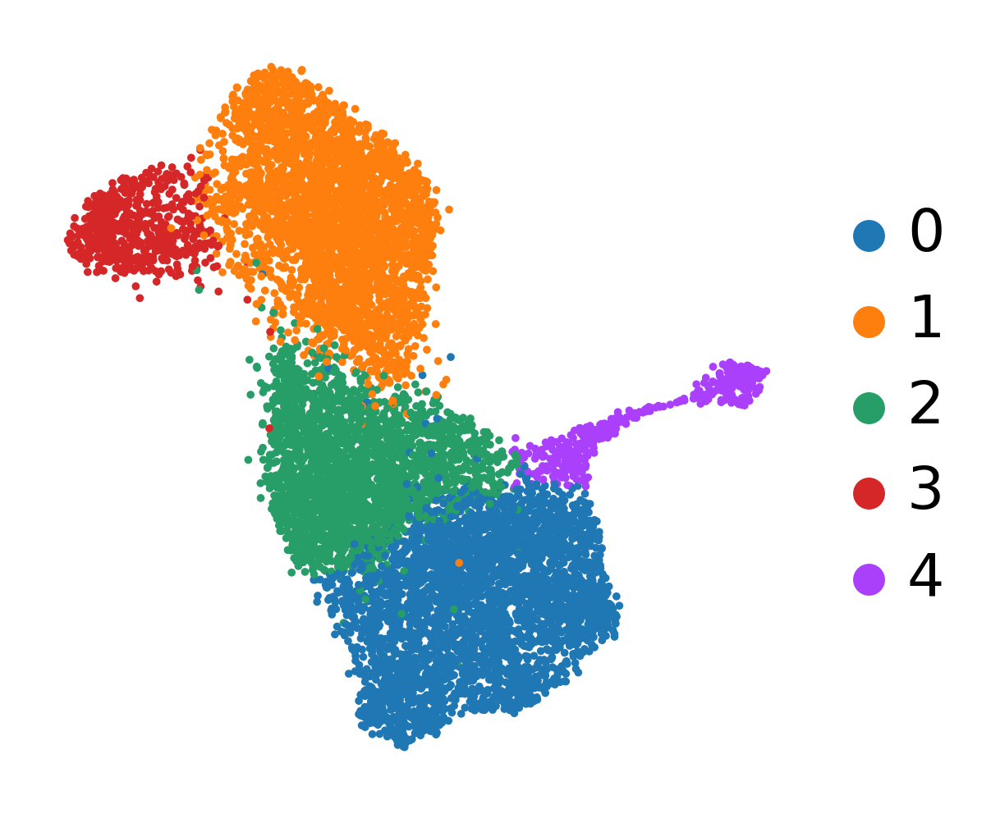

In [78]:
sc.pl.umap(adata_both, color='orig.ident',save="_both_orig_ident.pdf",title='')
sc.pl.umap(adata_both, color='ident_2',palette=["#0000FF","#000080","#FF0000","#731d1d","gray"],save="_both_ident.pdf")
sc.pl.umap(adata_both, color='eday',title='',save="_both_eday.pdf")
sc.pl.umap(adata_both, color='nUMI',title='',save="_both_nUMI.pdf")
sc.pl.umap(adata_both, color='louvain_r0.5',title='',save="_both_louvain_r0.5.pdf")

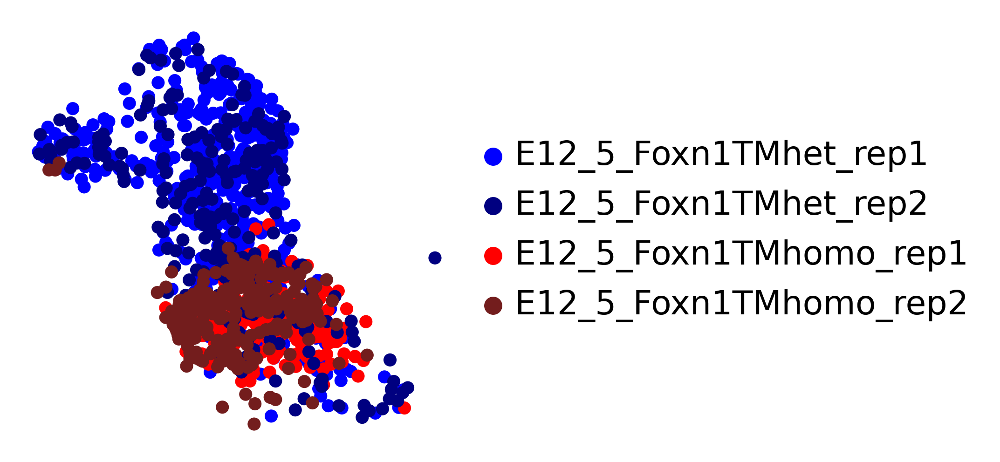

In [79]:
sc.pl.umap(adata_KO_proc, color='orig.ident',title='',palette=["#0000FF","#000080","#FF0000","#731d1d"],save="_KO_Het_orig_ident.pdf")

In [80]:
umaps = pd.DataFrame(data = adata_both.obsm['X_umap'],index = adata_both.obs_names, columns=['umap_1','umap_2'])
umaps['louvain_r0.5'] = adata_both.obs['louvain_r0.5']
umaps.to_csv(results_file+"umap_coordinates.csv")

... storing 'orig.ident' as categorical
... storing 'is_ko' as categorical


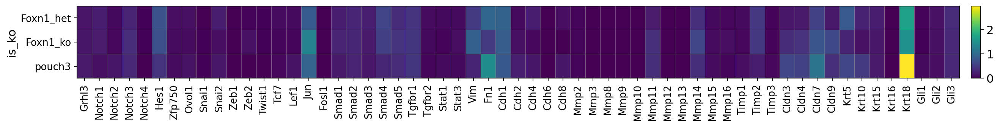

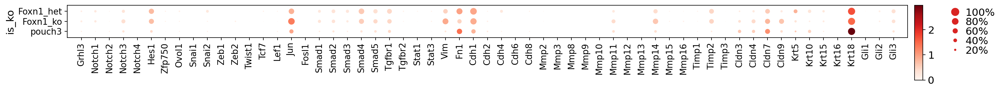

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[20.65, 0, 0.2, 0.5, 0.25])

In [81]:
expected_genes = ['Grhl3','Notch1','Notch2','Notch3','Notch4','Hes1','Zfp750','Ovol1','Snai1', 
'Snai2','Zeb1','Zeb2','Twist1','Tcf7','Lef1','Jun','Fosl1','Smad1','Smad2','Smad3','Smad4','Smad5','Tgfbr1','Tgfbr2','Stat1',
'Stat3','Jak2''Nfkb1','Vim','Fn1','Cdh1','Cdh2','Cdh4','Cdh6','Cdh8','Mmp2','Mmp3','Mmp8','Mmp9','Mmp10','Mmp11','Mmp12',
'Mmp13','Mmp14','Mmp15','Mmp16','Timp1','Timp2','Timp3','Cldn3','Cldn4','Cldn7','Cldn9','Krt5','Krt10','Krt15','Krt16','Krt18',
'Gli1','Gli2','Gli3']
expected_genes_proc = [x for x in expected_genes if x in adata_pouch3.var_names]
sc.set_figure_params( dpi_save=300)
sc.pl.matrixplot(adata_both_log_norm, expected_genes_proc, groupby='is_ko',save= '_selectedgenes_log_norm.pdf')
sc.pl.dotplot(adata_both_log_norm, expected_genes_proc, groupby='is_ko',save= '_selectedgenes_log_norm.pdf')

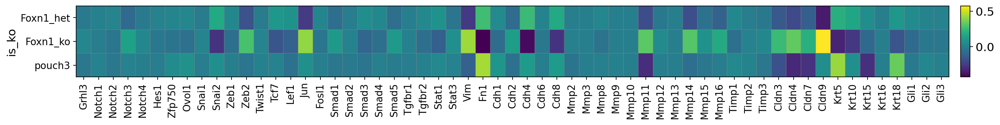

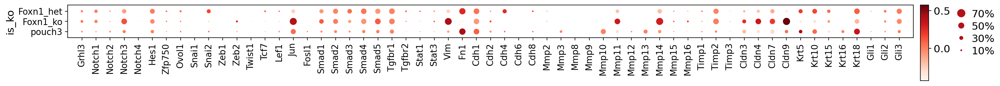

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[20.65, 0, 0.2, 0.5, 0.25])

In [82]:
expected_genes = ['Grhl3','Notch1','Notch2','Notch3','Notch4','Hes1','Zfp750','Ovol1','Snai1', 
'Snai2','Zeb1','Zeb2','Twist1','Tcf7','Lef1','Jun','Fosl1','Smad1','Smad2','Smad3','Smad4','Smad5','Tgfbr1','Tgfbr2','Stat1',
'Stat3','Jak2''Nfkb1','Vim','Fn1','Cdh1','Cdh2','Cdh4','Cdh6','Cdh8','Mmp2','Mmp3','Mmp8','Mmp9','Mmp10','Mmp11','Mmp12',
'Mmp13','Mmp14','Mmp15','Mmp16','Timp1','Timp2','Timp3','Cldn3','Cldn4','Cldn7','Cldn9','Krt5','Krt10','Krt15','Krt16','Krt18',
'Gli1','Gli2','Gli3']
expected_genes_proc = [x for x in expected_genes if x in adata_pouch3.var_names]
sc.set_figure_params( dpi_save=300)
sc.pl.matrixplot(adata_both, expected_genes_proc, groupby='is_ko')#,save= '_selectedgenes.pdf')
sc.pl.dotplot(adata_both, expected_genes_proc, groupby='is_ko')#,save= '_selectedgenes.pdf')

In [83]:
adata_KO = adata_KO_proc[adata_KO_proc.obs[adata_KO_proc.obs['is_ko']=='Foxn1_ko'].index]
adata_Het = adata_KO_proc[adata_KO_proc.obs[adata_KO_proc.obs['is_ko']=='Foxn1_het'].index]

In [96]:
adata_both_log_norm.write(results_file+"./adata_both_log_norm_bb.h5ad")
adata_both.write(results_file+"./adata_both_bb.h5ad")

In [97]:
adata_pouch3.write(results_file+"adata_pouch3_bb.h5ad")
adata_pouch3_log_norm.write(results_file+"adata_pouch3_ln_bb.h5ad")
adata_KO_proc.write(results_file+"adata_KO_bb.h5ad")
adata_KO_log_norm.write(results_file+"adata_KO_ln_bb.h5ad")

Trying to set attribute `.obs` of view, copying.
... storing 'is_ko' as categorical


# 5. Differential test: Marker genes

### 5.1 pouch3 vs fox_KO

In [93]:
pouch3_KO_Het_indices = set([x for x in adata_both.obs_names[pouch3_cells_ingest[0]]] + [x for x in adata_KO_proc.obs_names
                                                                                     ])

In [94]:
#differential test with respect to third pouch and KO/Het
adata_pouch3_KO_Het = adata_both_log_norm[list(pouch3_KO_Het_indices)].copy()
sc.tl.rank_genes_groups(adata_pouch3_KO_Het, groupby='is_ko', key_added='rank_genes')

#differential test between KO and Het
adata_KO_Het = adata_both_log_norm[adata_KO_proc.obs_names].copy()
sc.tl.rank_genes_groups(adata_KO_Het, groupby='is_ko', key_added='rank_genes')

ranking genes
    finished: added to `.uns['rank_genes']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes
    finished: added to `.uns['rank_genes']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


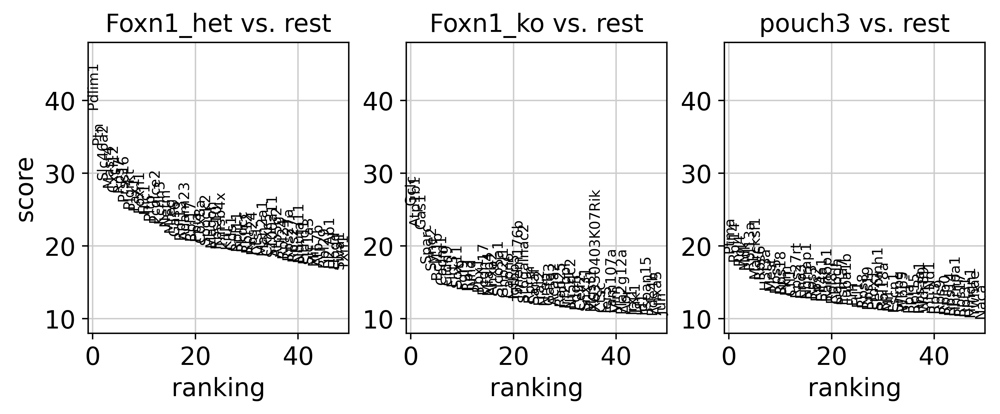

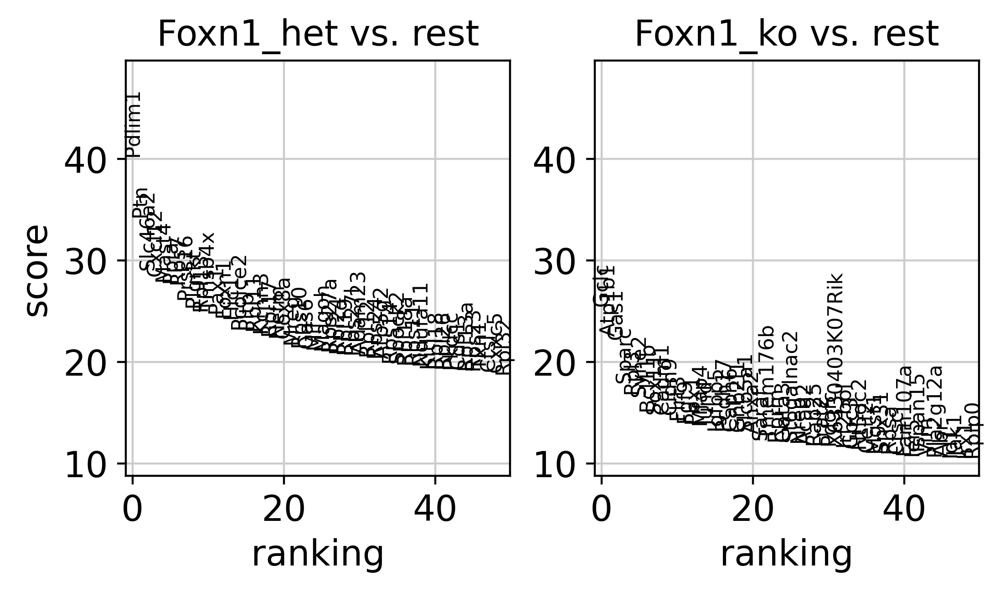

In [95]:
sc.pl.rank_genes_groups(adata_pouch3_KO_Het,  key='rank_genes', n_genes=50,save= '_pouch3_KO_Het.pdf')
sc.pl.rank_genes_groups(adata_KO_Het,  key='rank_genes', n_genes=50,save= '_KO_Het.pdf')

### 5.2 KO vs Het

In [122]:
mg = []
clusters = set(adata_KO_Het.obs['is_ko'])
markers_KO_Het = pd.DataFrame(columns = clusters)
test = pd.DataFrame()
list_mg_KO_Het = []
for clust in clusters:
    mg = adata_KO_Het.uns['rank_genes']['names'][clust][:50]
    score = adata_KO_Het.uns['rank_genes']['scores'][clust][:50]
    logfc = adata_KO_Het.uns['rank_genes']['logfoldchanges'][clust][:50]
    pval = adata_KO_Het.uns['rank_genes']['pvals'][clust][:50]
    qval = adata_KO_Het.uns['rank_genes']['pvals_adj'][clust][:50]
    list_mg_KO_Het.extend(mg)
    markers_KO_Het.loc[:,clust] = mg
    i=0
    for g in mg:
        pt = pd.Series([clust,mg[i],score[i],logfc[i],pval[i],qval[i]],['cluster','gene','logFC','score','pvalue','pvalue_adj'])
        test = test.append([pt], ignore_index=True)
        i=i+1
        if i>1000:
            break
test.to_csv(results_file+"rank_genes_KO_Het.csv")


### 5.3 Pouch3 clusters

In [117]:
adata_pouch3_log_norm = adata_pouch3_log_norm[adata_pouch3.obs_names]
adata_pouch3_log_norm.obs = adata_pouch3.obs

In [118]:
#Calculate marker genes
sc.tl.rank_genes_groups(adata_pouch3_log_norm, groupby='louvain_r1', key_added='rank_genes_r1')

ranking genes
    finished: added to `.uns['rank_genes_r1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


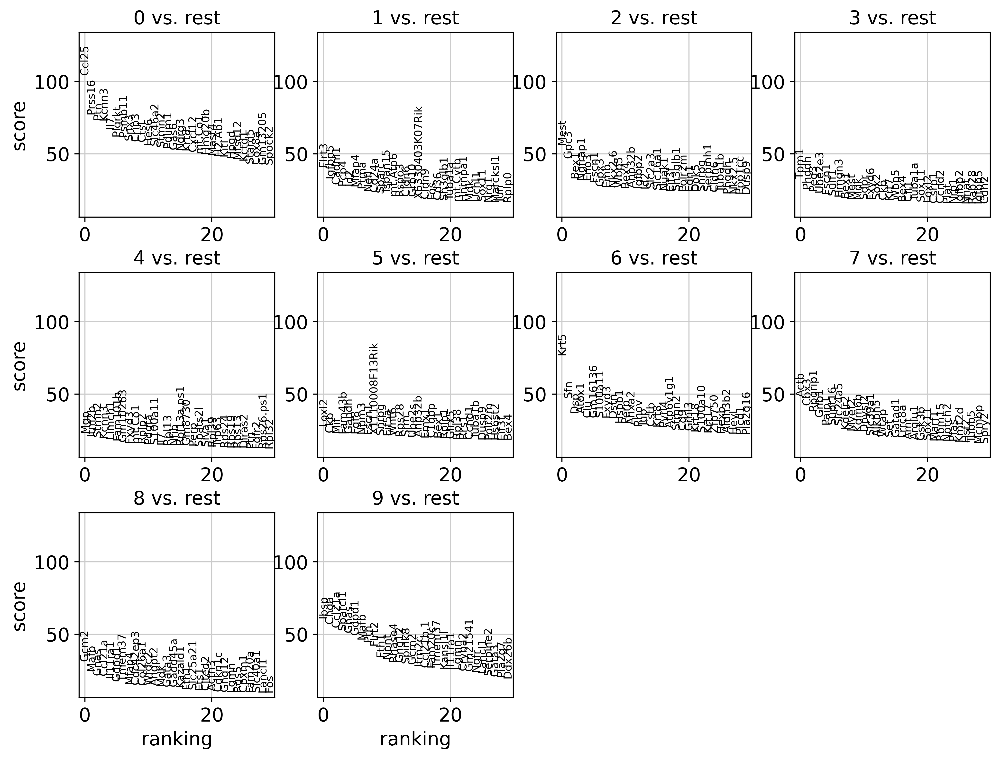

In [119]:
sc.pl.rank_genes_groups(adata_pouch3_log_norm,  key='rank_genes_r1', n_genes=30)#, save= '_pouch3_louvain_r1.pdf')

In [120]:
#Calculate marker genes
sc.tl.rank_genes_groups(adata_pouch3_log_norm, groupby='louvain_r0.5', key_added='rank_genes_r0.5')

ranking genes
    finished: added to `.uns['rank_genes_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


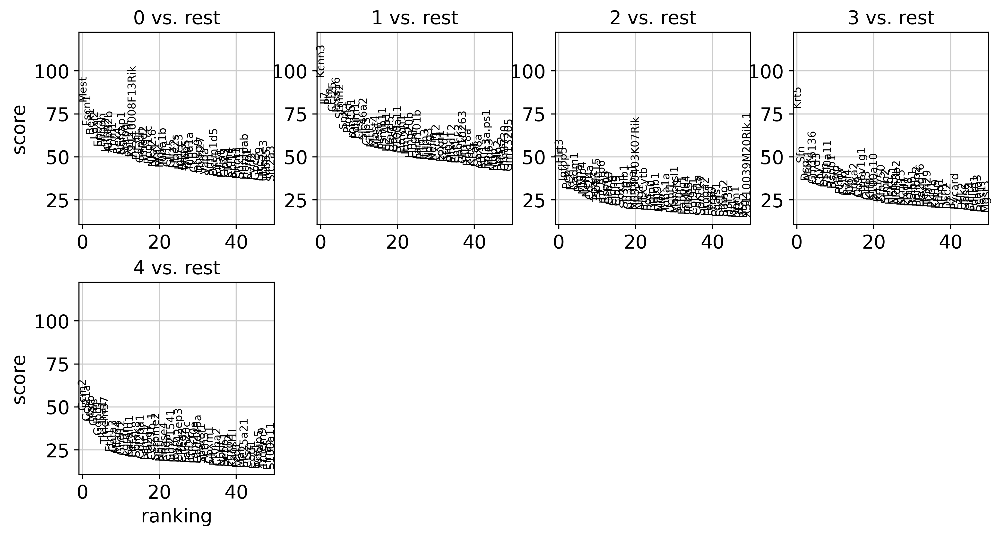

In [121]:
sc.pl.rank_genes_groups(adata_pouch3_log_norm,  key='rank_genes_r0.5', n_genes=50, save= '_pouch3_louvain0.5.pdf')

In [148]:
mg = []
clusters = set(adata_pouch3_log_norm.obs['louvain_r1'])
markers_pouch3_r1 = pd.DataFrame(columns = clusters)
test = pd.DataFrame()
list_mg_pouch3_r1 = []
for clust in clusters:
    mg = adata_pouch3_log_norm.uns['rank_genes_r1']['names'][clust][:50]
    score = adata_pouch3_log_norm.uns['rank_genes_r1']['scores'][clust][:50]
    logfc = adata_pouch3_log_norm.uns['rank_genes_r1']['logfoldchanges'][clust][:50]
    pval = adata_pouch3_log_norm.uns['rank_genes_r1']['pvals'][clust][:50]
    qval = adata_pouch3_log_norm.uns['rank_genes_r1']['pvals_adj'][clust][:50]
    list_mg_pouch3_r1.extend(mg)
    markers_pouch3_r1.loc[:,clust] = mg
    i=0
    for g in mg:
        pt = pd.Series([clust,mg[i],score[i],logfc[i],pval[i],qval[i]],['cluster','gene','logFC','score','pvalue','pvalue_adj'])
        test = test.append([pt], ignore_index=True)
        i=i+1
        if i>1000:
            break
test.to_csv(results_file+"rank_genes_r1.csv")

In [191]:
mg = []
clusters = set(adata_pouch3_log_norm.obs['louvain_r0.5'])
markers_pouch3_r5 = pd.DataFrame(columns = clusters)
test = pd.DataFrame()
list_mg_pouch3_r5 = []
for clust in clusters:
    mg = adata_pouch3_log_norm.uns['rank_genes_r0.5']['names'][clust][:50]
    score = adata_pouch3_log_norm.uns['rank_genes_r0.5']['scores'][clust][:50]
    logfc = adata_pouch3_log_norm.uns['rank_genes_r0.5']['logfoldchanges'][clust][:50]
    pval = adata_pouch3_log_norm.uns['rank_genes_r0.5']['pvals'][clust][:50]
    qval = adata_pouch3_log_norm.uns['rank_genes_r0.5']['pvals_adj'][clust][:50]
    list_mg_pouch3_r5.extend(mg)
    markers_pouch3_r5.loc[:,clust] = mg
    i=0
    for g in mg:
        pt = pd.Series([clust,mg[i],score[i],logfc[i],pval[i],qval[i]],['cluster','gene','logFC','score','pvalue','pvalue_adj'])
        test = test.append([pt], ignore_index=True)
        i=i+1
        if i>1000:
            break
test.to_csv(results_file+"rank_genes_r0.5.csv")

# 6. Trajectory inference and pseudotime analysis

In [128]:
adata_pouch3.obs['ident'].value_counts()

10.5_11.5_c2         4832
12.5_c1              2784
12.5_c4               486
11.5_12.5_c3          375
10.5_11.5_c1           75
10.5_11.5_c3           62
11.5_c2                22
10.5_11.5_12.5_c1      21
11.5_12.5_c1           21
11.5_c1                16
9.5_c1                  7
10.5_11.5_c4            5
10.5_11.5_c5            3
11.5_12.5_c2            2
9.5_c7                  2
10.5_11.5_c6            1
9.5_c5                  1
9.5_c4                  1
9.5_c3                  1
Name: ident, dtype: int64

In [131]:
cells_9_5 = adata_pouch3[(adata_pouch3.obs['ident']=='9.5_c1') | (adata_pouch3.obs['ident']=='9.5_c3')
                                       | (adata_pouch3.obs['ident']=='9.5_c4') | (adata_pouch3.obs['ident']=='9.5_c5')
                                       | (adata_pouch3.obs['ident']=='9.5_c7')].obs_names
adata_pouch3.obs['9.5'] = 0
for x in cells_9_5:
    adata_pouch3.obs.loc[x,'9.5'] = 1

## 6.1 Diffusion Pseudotime (DPT)

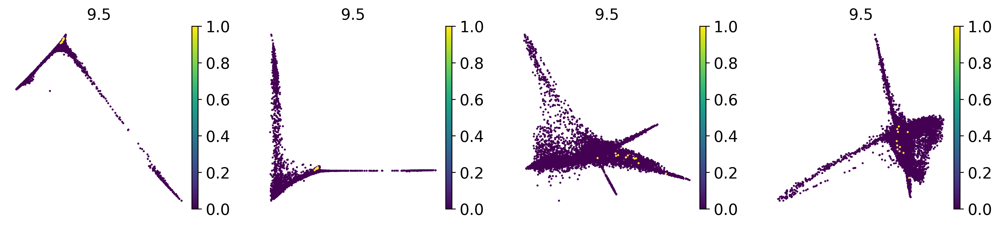

In [132]:
sc.pl.diffmap(adata_pouch3, color='9.5', components=['1,2','1,3','4,5','6,7'],save="_pouch3_diffmap_9.5.pdf") #, palette=sc.pl.palettes.godsnot_64)

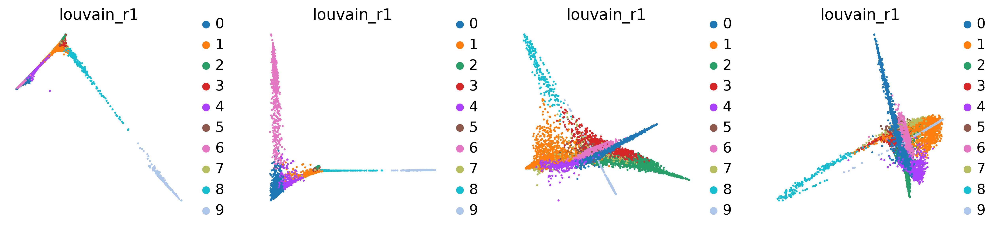

In [133]:
sc.pl.diffmap(adata_pouch3, color='louvain_r1', components=['1,2','1,3','4,5','6,7'])#,save="_pouch3_diffmap_louvain.pdf")#, palette=sc.pl.palettes.godsnot_64)

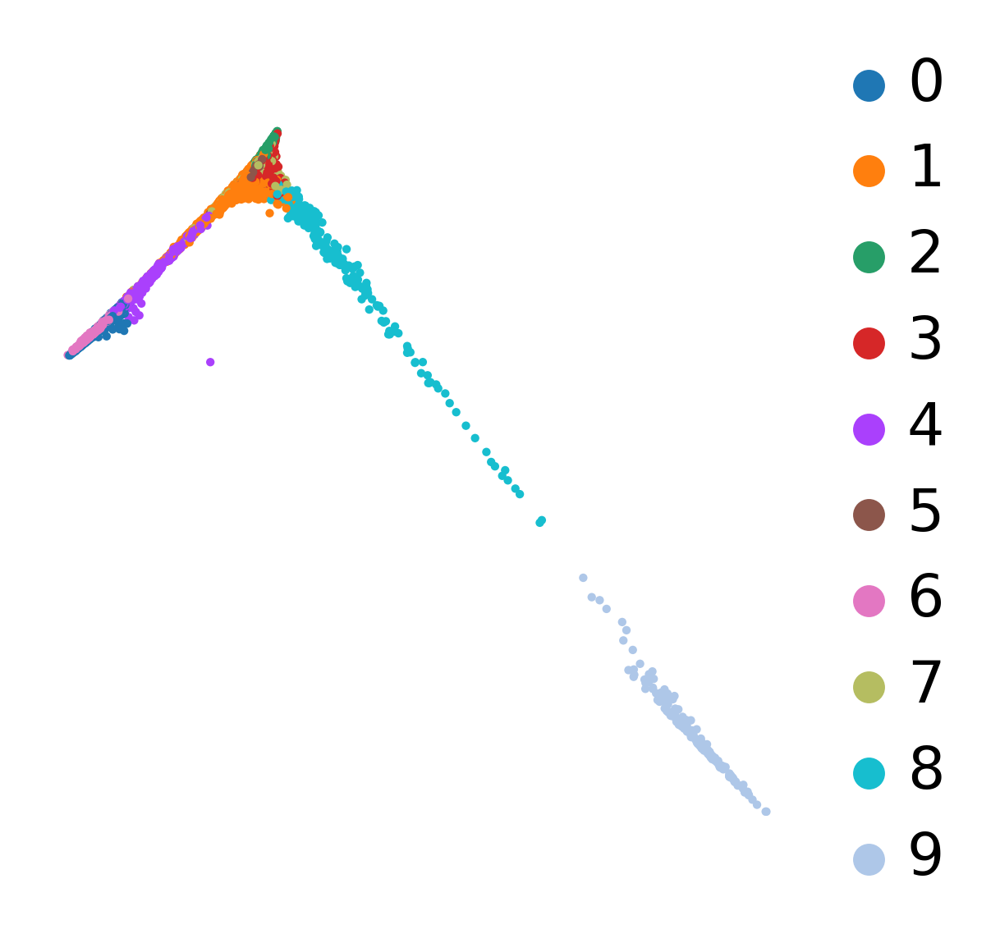

In [134]:
sc.pl.diffmap(adata_pouch3, color='louvain_r1',title='', components=['1,2'])#, palette=sc.pl.palettes.godsnot_64)

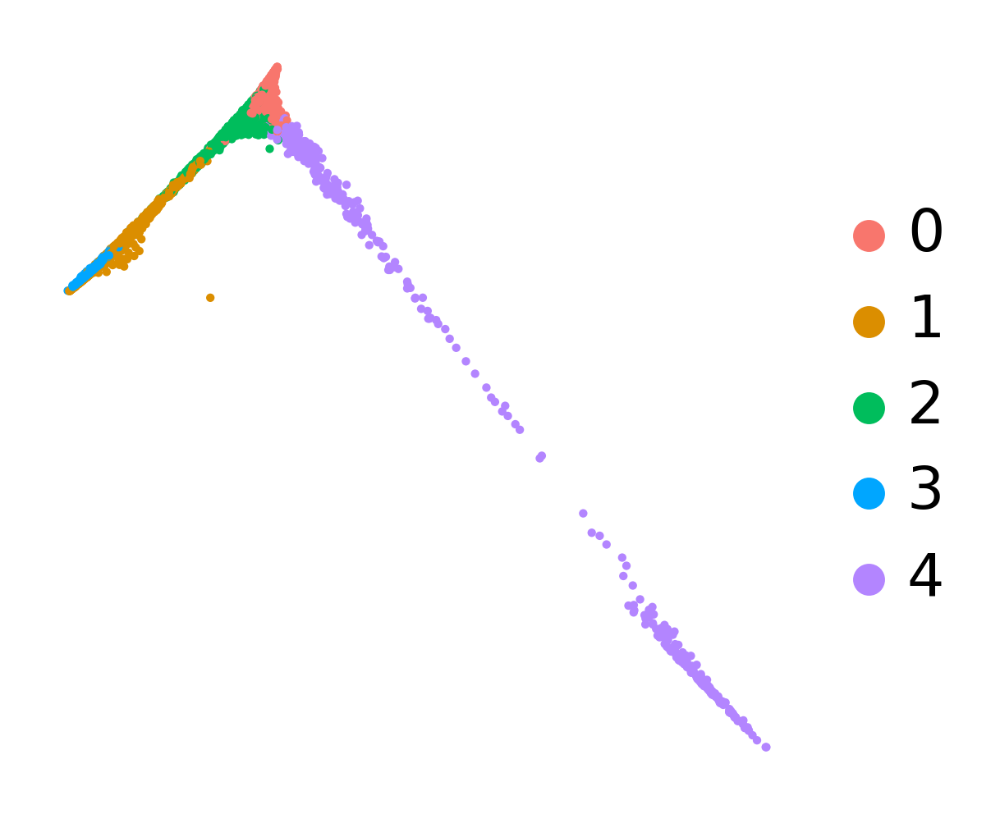

In [135]:
sc.pl.diffmap(adata_pouch3, color='louvain_r0.5',title='', components=['1,2'],palette=["#F8766D","#DB8E00","#00BD5C","#00A6FF","#B385FF","#EF67EB","#FF63B6"],save="_pouch3_louvain_05.pdf")#, palette=sc.pl.palettes.godsnot_64)

In [136]:
#Find the stem cell with the highest DC2 value to act as root for the diffusion pseudotime and compute DPT
stem_mask = np.isin(adata_pouch3.obs['9.5'], 1)
max_stem_id = np.argmax(adata_pouch3.obsm['X_diffmap'][stem_mask,1])
root_id = np.arange(len(stem_mask))[stem_mask][max_stem_id]
adata_pouch3.uns['iroot'] = root_id
print(root_id)
#Compute dpt
sc.tl.dpt(adata_pouch3)

2125
computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


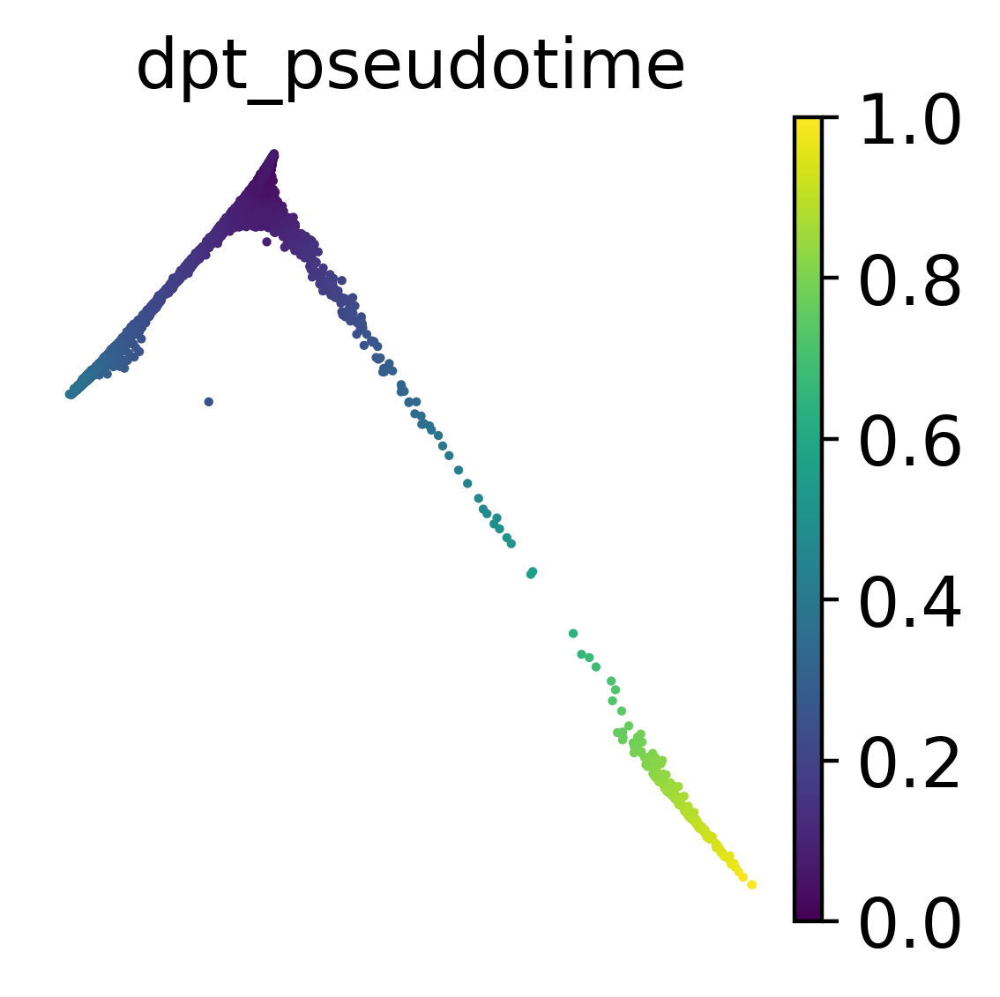

In [137]:
sc.pl.diffmap(adata_pouch3, components='1,2', color='dpt_pseudotime',save="_pouch3_pseudotime.pdf",color_map='viridis')

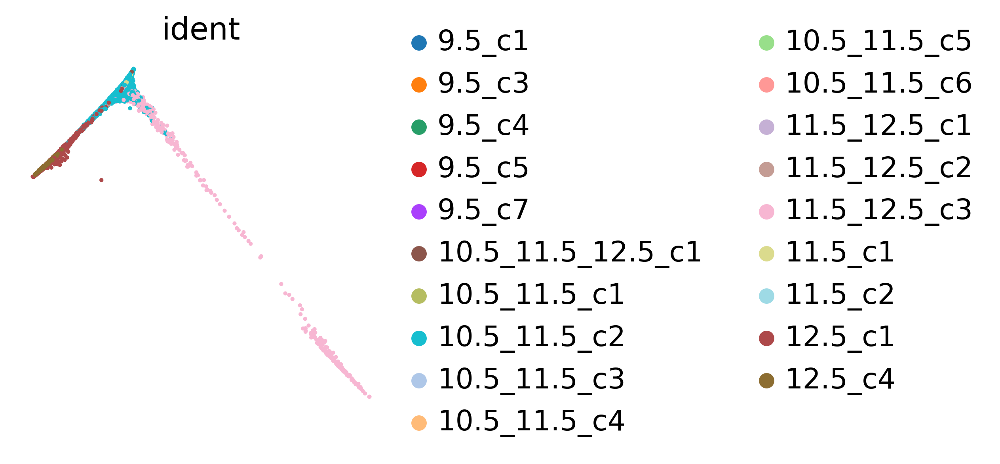

In [138]:
#Visualize pseudotime over differentiation
sc.pl.diffmap(adata_pouch3, components='1,2', color='ident',save="_pouch3_diffmap_ident.pdf")

In [139]:
adata_pouch3.obs['DC1'] = adata_pouch3.obsm['X_diffmap'][:,0]
adata_pouch3.obs['DC2'] = adata_pouch3.obsm['X_diffmap'][:,1]